In [2]:
import json
import pandas as pd
import matplotlib.pyplot as plt

# Path to your dataset
json_path = "../FINAL_CORRECTED_MET_TEXTILES_DATASET/objects_with_images_only/ALL_TEXTILES_AND_TAPESTRIES_WITH_IMAGES_20250705_230315.json"

with open(json_path, "r", encoding="utf-8") as f:
    data = json.load(f)

# Convert to DataFrame for easy analysis
df = pd.DataFrame(data)

# Show available columns
print(df.columns)
df[["objectID", "classification", "department", "title"]].head()

Index(['objectID', 'isHighlight', 'accessionNumber', 'accessionYear',
       'isPublicDomain', 'primaryImage', 'primaryImageSmall',
       'additionalImages', 'constituents', 'department', 'objectName', 'title',
       'culture', 'period', 'dynasty', 'reign', 'portfolio', 'artistRole',
       'artistPrefix', 'artistDisplayName', 'artistDisplayBio', 'artistSuffix',
       'artistAlphaSort', 'artistNationality', 'artistBeginDate',
       'artistEndDate', 'artistGender', 'artistWikidata_URL', 'artistULAN_URL',
       'objectDate', 'objectBeginDate', 'objectEndDate', 'medium',
       'dimensions', 'measurements', 'creditLine', 'geographyType', 'city',
       'state', 'county', 'country', 'region', 'subregion', 'locale', 'locus',
       'excavation', 'river', 'classification', 'rightsAndReproduction',
       'linkResource', 'metadataDate', 'repository', 'objectURL', 'tags',
       'objectWikidata_URL', 'isTimelineWork', 'GalleryNumber'],
      dtype='object')


,objectID,classification,department,title
0,229636,Textiles-Laces,European Sculpture and Decorative Arts,Cap crown
1,229605,Textiles-Velvets,European Sculpture and Decorative Arts,Length
2,229642,Textiles-Laces,European Sculpture and Decorative Arts,Pair of lappets
3,229639,Textiles-Laces,European Sculpture and Decorative Arts,Two joined lappets and papillon edging
4,229667,Textiles-Woven,European Sculpture and Decorative Arts,Piece


In [3]:
# Show departments for objectIDs in the 20,000–35,000 range
mask = (df["objectID"] >= 20000) & (df["objectID"] <= 35000)
print(df.loc[mask, ["objectID", "classification", "department", "title"]].head(20))

     objectID   classification      department  \
520     25387          Helmets  Arms and Armor   
521     25091  Shafted Weapons  Arms and Armor   
522     25122  Shafted Weapons  Arms and Armor   
523     26685  Shafted Weapons  Arms and Armor   
524     26677  Shafted Weapons  Arms and Armor   
525     26668  Shafted Weapons  Arms and Armor   
526     31122           Swords  Arms and Armor   
527     31095           Swords  Arms and Armor   
528     31006           Swords  Arms and Armor   
529     33578  Shafted Weapons  Arms and Armor   
530     27119        Forgeries  Arms and Armor   
531     27042  Shafted Weapons  Arms and Armor   
532     27047  Shafted Weapons  Arms and Armor   
533     27055  Shafted Weapons  Arms and Armor   
534     27057  Shafted Weapons  Arms and Armor   
535     27081          Helmets  Arms and Armor   
536     25018  Shafted Weapons  Arms and Armor   
537     25015  Shafted Weapons  Arms and Armor   
538     25658  Shafted Weapons  Arms and Armor   


In [4]:
import json

# Load textiles and tapestries objectIDs
with open("../FINAL_CORRECTED_MET_TEXTILES_DATASET/objects_with_images_only/textiles_with_images_20250705_230315.json", "r", encoding="utf-8") as f:
    textiles = json.load(f)
with open("../FINAL_CORRECTED_MET_TEXTILES_DATASET/objects_with_images_only/tapestries_with_images_20250705_230315.json", "r", encoding="utf-8") as f:
    tapestries = json.load(f)

textile_ids = set(obj["objectID"] for obj in textiles)
tapestry_ids = set(obj["objectID"] for obj in tapestries)

In [5]:
def precise_category(row):
    oid = row["objectID"]
    if oid in tapestry_ids:
        return "Tapestry"
    elif oid in textile_ids:
        return "Textile"
    else:
        return "Other"

df["precise_category"] = df.apply(precise_category, axis=1)

In [6]:
def precise_category(row):
    oid = row["objectID"]
    if oid in tapestry_ids:
        return "Tapestry"
    elif oid in textile_ids:
        return "Textile"
    else:
        return "Other"

df["precise_category"] = df.apply(precise_category, axis=1)

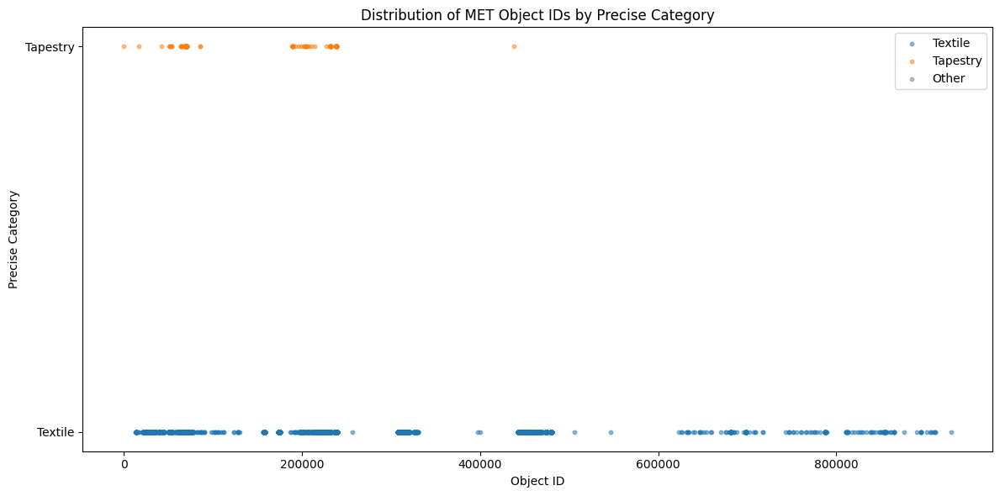

In [7]:
plt.figure(figsize=(12, 6))
for cat, color in zip(["Textile", "Tapestry", "Other"], ["tab:blue", "tab:orange", "tab:gray"]):
    subset = df[df["precise_category"] == cat]
    plt.scatter(subset["objectID"], [cat]*len(subset), label=cat, alpha=0.5, s=10, color=color)

plt.xlabel("Object ID")
plt.ylabel("Precise Category")
plt.title("Distribution of MET Object IDs by Precise Category")
plt.legend()
plt.tight_layout()
plt.show()

In [8]:
mask = (df["objectID"] >= 20000) & (df["objectID"] <= 35000)
print(df.loc[mask, ["objectID", "precise_category", "classification", "department", "title"]].head(20))

     objectID precise_category   classification      department  \
520     25387          Textile          Helmets  Arms and Armor   
521     25091          Textile  Shafted Weapons  Arms and Armor   
522     25122          Textile  Shafted Weapons  Arms and Armor   
523     26685          Textile  Shafted Weapons  Arms and Armor   
524     26677          Textile  Shafted Weapons  Arms and Armor   
525     26668          Textile  Shafted Weapons  Arms and Armor   
526     31122          Textile           Swords  Arms and Armor   
527     31095          Textile           Swords  Arms and Armor   
528     31006          Textile           Swords  Arms and Armor   
529     33578          Textile  Shafted Weapons  Arms and Armor   
530     27119          Textile        Forgeries  Arms and Armor   
531     27042          Textile  Shafted Weapons  Arms and Armor   
532     27047          Textile  Shafted Weapons  Arms and Armor   
533     27055          Textile  Shafted Weapons  Arms and Armo

In [9]:
mask = (df["objectID"] >= 20000) & (df["objectID"] <= 35000)
print(df.loc[mask, ["objectID", "precise_category", "classification", "department", "title"]].value_counts("precise_category"))

precise_category
Textile    414
Name: count, dtype: int64


department
European Sculpture and Decorative Arts    15769
Asian Art                                  5504
Islamic Art                                3276
The Michael C. Rockefeller Wing             830
Modern and Contemporary Art                 657
Arms and Armor                              470
Medieval Art                                445
Robert Lehman Collection                    266
The Cloisters                                82
Ancient Near Eastern Art                     43
The American Wing                            20
Costume Institute                             5
Drawings and Prints                           2
Egyptian Art                                  1
Greek and Roman Art                           1
Musical Instruments                           1
European Paintings                            1
Name: count, dtype: int64


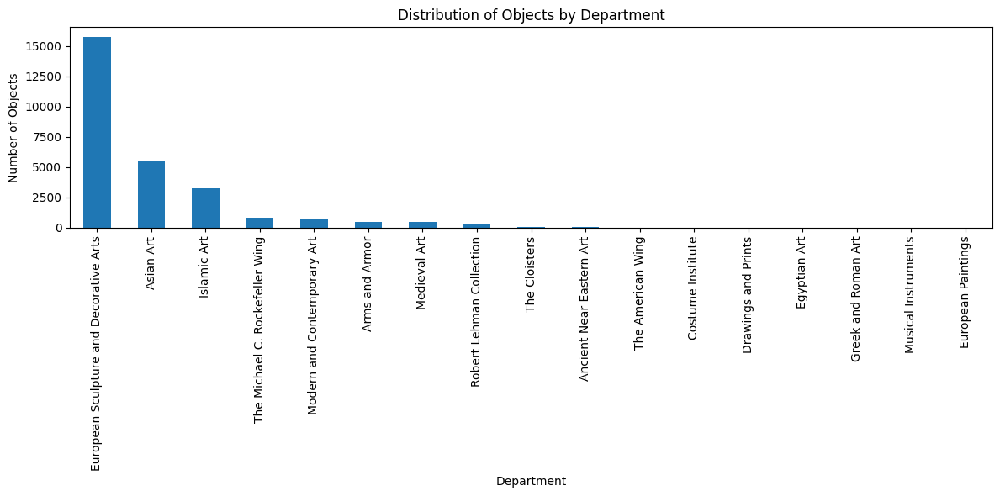

In [10]:
# List all unique departments and their counts
dept_counts = df['department'].value_counts()
print(dept_counts)

# Visualize department distribution
plt.figure(figsize=(12, 6))
dept_counts.plot(kind='bar')
plt.xlabel("Department")
plt.ylabel("Number of Objects")
plt.title("Distribution of Objects by Department")
plt.tight_layout()
plt.show()

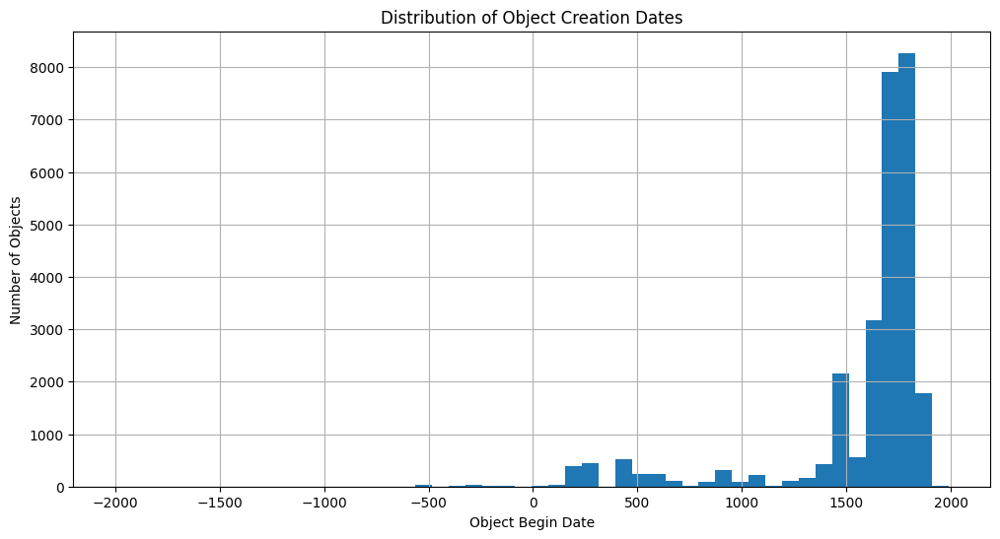

In [11]:
df['objectBeginDate'] = pd.to_numeric(df['objectBeginDate'], errors='coerce')
plt.figure(figsize=(12,6))
df['objectBeginDate'].dropna().astype(int).hist(bins=50)
plt.xlabel("Object Begin Date")
plt.ylabel("Number of Objects")
plt.title("Distribution of Object Creation Dates")
plt.show()

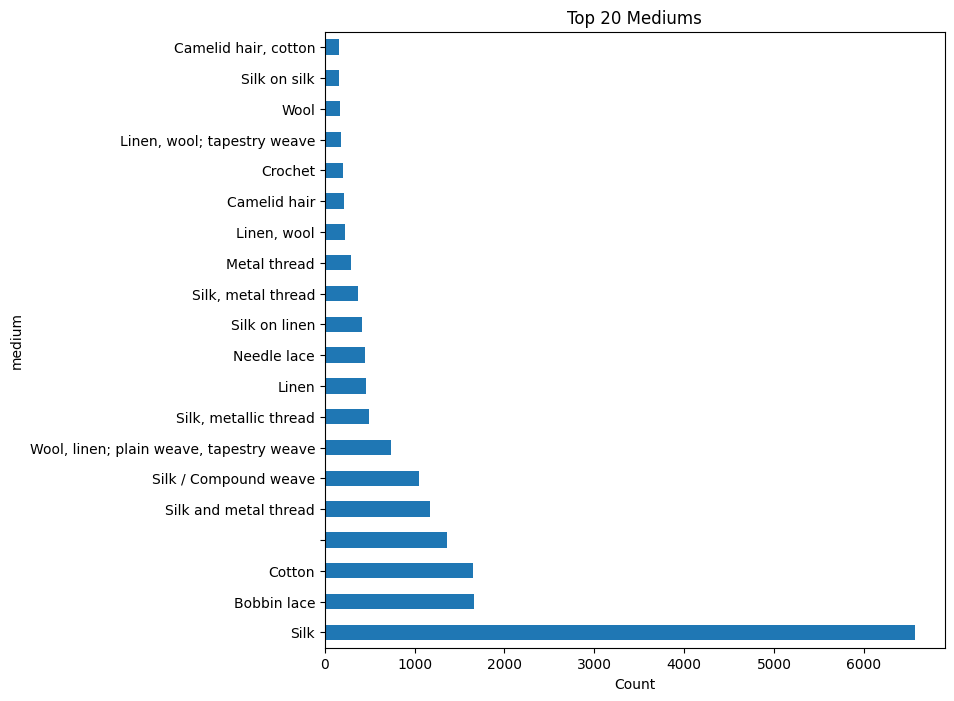

In [12]:
df['medium'].value_counts().head(20).plot(kind='barh', figsize=(8,8))
plt.xlabel("Count")
plt.title("Top 20 Mediums")
plt.show()

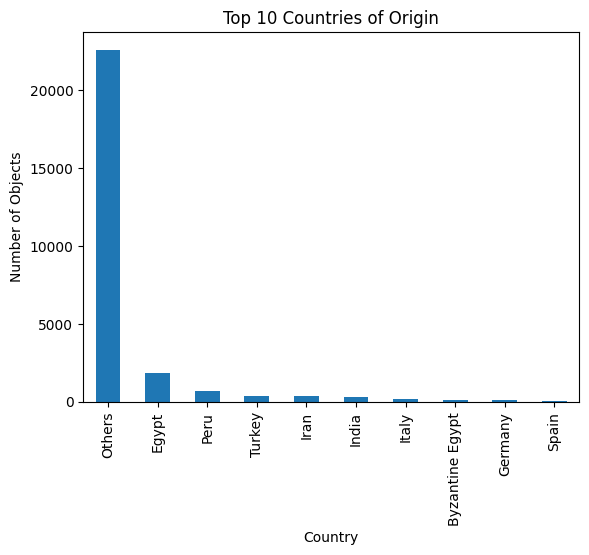

In [13]:
df['country'] = df['country'].replace('', 'Others').fillna('Others')
df['country'].value_counts().head(10).plot(kind='bar')
plt.xlabel("Country")
plt.ylabel("Number of Objects")
plt.title("Top 10 Countries of Origin")
plt.show()

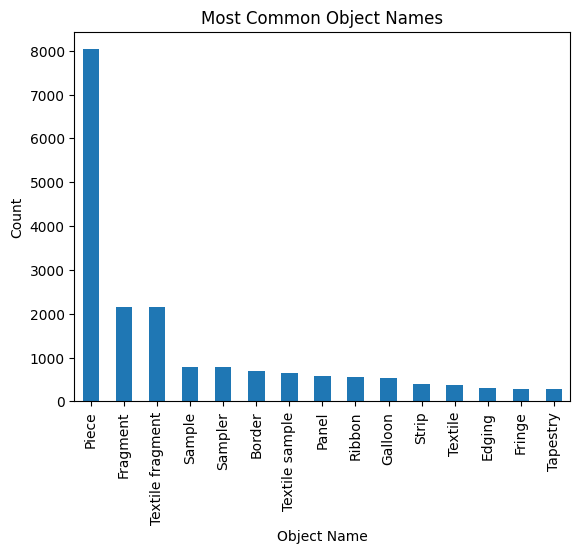

In [14]:
df['objectName'].value_counts().head(15).plot(kind='bar')
plt.xlabel("Object Name")
plt.ylabel("Count")
plt.title("Most Common Object Names")
plt.show()

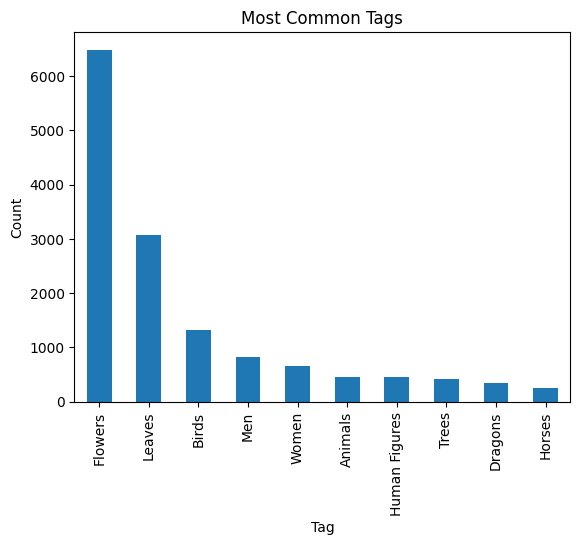

In [15]:
from collections import Counter
tag_terms = [tag['term'] for tags in df['tags'].dropna() for tag in tags]
pd.Series(Counter(tag_terms)).sort_values(ascending=False).head(10).plot(kind='bar')
plt.xlabel("Tag")
plt.ylabel("Count")
plt.title("Most Common Tags")
plt.show()

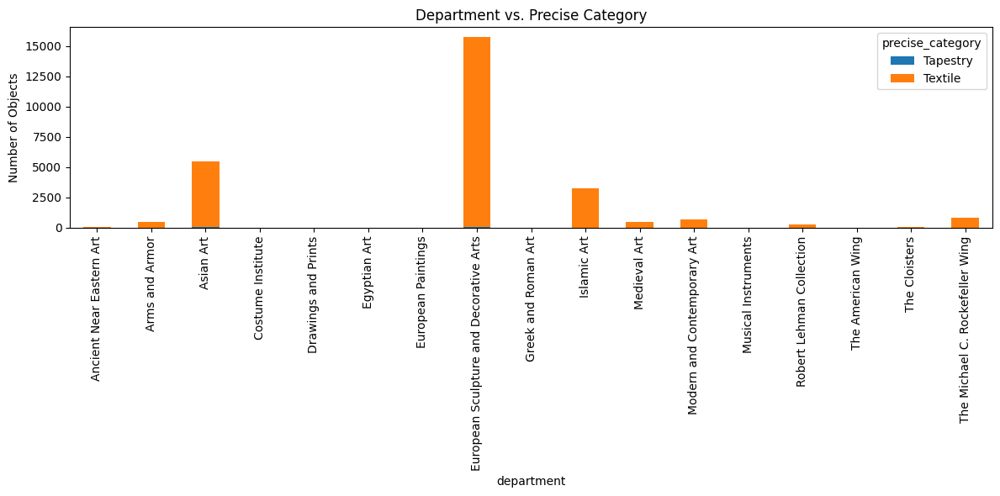

In [16]:
pd.crosstab(df['department'], df['precise_category']).plot(kind='bar', stacked=True, figsize=(12,6))
plt.ylabel("Number of Objects")
plt.title("Department vs. Precise Category")
plt.tight_layout()
plt.show()

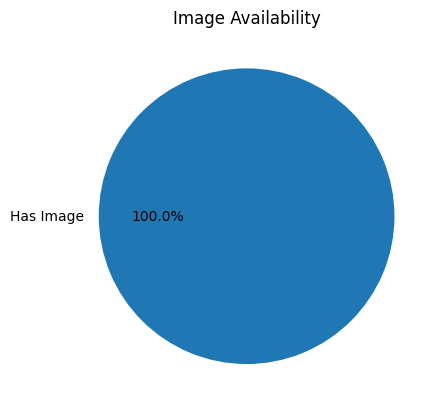

In [17]:
has_image = df['primaryImage'].apply(lambda x: bool(x)).value_counts()
has_image.plot(kind='pie', labels=['Has Image', 'No Image'], autopct='%1.1f%%')
plt.title("Image Availability")
plt.ylabel("")
plt.show()

In [18]:
print("==== DATASET SUMMARY ====")
print(f"Total objects: {len(df)}")
print(f"Unique departments: {df['department'].nunique()}")
print(f"Unique classifications: {df['classification'].nunique()}")
print(f"Unique object names: {df['objectName'].nunique()}")
print(f"Unique countries: {df['country'].replace('', 'Others').fillna('Others').nunique()}")
print(f"Objects with images: {df['primaryImage'].apply(bool).sum()} ({df['primaryImage'].apply(bool).mean()*100:.2f}%)")
print(f"Objects with tags: {df['tags'].notna().sum()} ({df['tags'].notna().mean()*100:.2f}%)")
print("\nTop 5 departments:")
print(df['department'].value_counts().head())
print("\nTop 5 classifications:")
print(df['classification'].value_counts().head())
print("\nTop 5 object names:")
print(df['objectName'].value_counts().head())
print("\nTop 5 countries:")
print(df['country'].replace('', 'Others').fillna('Others').value_counts().head())
print("=========================")

==== DATASET SUMMARY ====
Total objects: 27373
Unique departments: 17
Unique classifications: 125
Unique object names: 1214
Unique countries: 188
Objects with images: 27373 (100.00%)
Objects with tags: 11442 (41.80%)

Top 5 departments:
department
European Sculpture and Decorative Arts    15769
Asian Art                                  5504
Islamic Art                                3276
The Michael C. Rockefeller Wing             830
Modern and Contemporary Art                 657
Name: count, dtype: int64

Top 5 classifications:
classification
Textiles-Woven          9225
Textiles-Laces          4262
Textiles-Embroidered    3818
Textiles-Trimmings      1872
Textiles                1847
Name: count, dtype: int64

Top 5 object names:
objectName
Piece               8028
Fragment            2166
Textile fragment    2150
Sample               794
Sampler              787
Name: count, dtype: int64

Top 5 countries:
country
Others    22603
Egypt      1826
Peru        712
Turkey      392
Ira

In [19]:
# Show all unique country names and their counts, sorted
country_counts = df['country'].replace('', 'Others').fillna('Others').value_counts()
print("All country counts:")
print(country_counts)
print(f"\nTotal unique countries: {country_counts.shape[0]}")

All country counts:
country
Others                         22603
Egypt                           1826
Peru                             712
Turkey                           392
Iran                             352
                               ...  
probably Spain                     1
Afghanistan or Turkmenistan        1
Egypt or Turkey                    1
Eastern Iran or Khurasan           1
Sweden                             1
Name: count, Length: 188, dtype: int64

Total unique countries: 188


FISHY

In [20]:
# Filter for the objectID range 20,000–35,000
mask = (df["objectID"] >= 20000) & (df["objectID"] <= 35000)
df_range = df.loc[mask]

print("==== DATASET SUMMARY (objectID 20,000–35,000) ====")
print(f"Total objects: {len(df_range)}")
print(f"Unique departments: {df_range['department'].nunique()}")
print(f"Unique classifications: {df_range['classification'].nunique()}")
print(f"Unique object names: {df_range['objectName'].nunique()}")
print(f"Unique countries: {df_range['country'].replace('', 'Others').fillna('Others').nunique()}")
print(f"Objects with images: {df_range['primaryImage'].apply(bool).sum()} ({df_range['primaryImage'].apply(bool).mean()*100:.2f}%)")
print(f"Objects with tags: {df_range['tags'].notna().sum()} ({df_range['tags'].notna().mean()*100:.2f}%)")
print("\nTop 5 departments:")
print(df_range['department'].value_counts().head())
print("\nTop 5 classifications:")
print(df_range['classification'].value_counts().head())
print("\nTop 5 object names:")
print(df_range['objectName'].value_counts().head())
print("\nTop 5 countries:")
print(df_range['country'].replace('', 'Others').fillna('Others').value_counts().head())
print("=========================")

==== DATASET SUMMARY (objectID 20,000–35,000) ====
Total objects: 414
Unique departments: 3
Unique classifications: 50
Unique object names: 203
Unique countries: 64
Objects with images: 414 (100.00%)
Objects with tags: 78 (18.84%)

Top 5 departments:
department
Arms and Armor                            412
European Sculpture and Decorative Arts      1
The American Wing                           1
Name: count, dtype: int64

Top 5 classifications:
classification
Shafted Weapons    129
Swords              52
Helmets             48
Armor for Man       22
Armor Parts         17
Name: count, dtype: int64

Top 5 object names:
objectName
Partisan      35
Halberd       35
Smallsword    19
Fauchard      14
Glaive        12
Name: count, dtype: int64

Top 5 countries:
country
Italy      101
Germany     72
France      41
Japan       23
England     19
Name: count, dtype: int64


In [21]:
print("==== CLASSIFICATION ANALYSIS (ALL DATA) ====")
print(f"Unique classifications: {df['classification'].nunique()}")
print("\nTop 10 classifications:")
print(df['classification'].value_counts().head(30))
print("\nAll classifications and their counts:")
print(df['classification'].value_counts())
print("=========================")

==== CLASSIFICATION ANALYSIS (ALL DATA) ====
Unique classifications: 125

Top 10 classifications:
classification
Textiles-Woven                      9225
Textiles-Laces                      4262
Textiles-Embroidered                3818
Textiles-Trimmings                  1872
Textiles                            1847
Textiles-Printed                    1665
Textiles-Velvets                    1356
Textiles-Tapestries                  552
Textiles-Rugs                        435
Textiles-Costumes                    351
Textiles-Methods and Materials       231
Shafted Weapons                      131
Textiles-Painted and/or Printed      120
Textiles-Implements                  110
Textiles-Painted and Printed         100
Textiles-Featherwork                  99
Woodwork-Furniture                    94
Textiles-Ecclesiastical               83
                                      70
Textiles-Woven-Brocade                69
Textiles-Brocades                     68
Textiles-Sample Books     

In [22]:
import os

# Path to your downloaded images directory
images_dir = "MET_TEXTILES_BULLETPROOF_DATASET/images"

# List all files in the directory (only files, not subdirectories)
downloaded_images = [f for f in os.listdir(images_dir) if os.path.isfile(os.path.join(images_dir, f))]
print(f"Total primary images downloaded: {len(downloaded_images)}")

# Optionally, show a sample of filenames
print("Sample image filenames:", downloaded_images[:10])

Total primary images downloaded: 27361
Sample image filenames: ['212672_Fragment_primary.jpg', '230549_Fragment_primary.jpg', '448109_Textile_Fragment_primary.jpg', '227209_Panel_primary.jpg', '227388_Piece_primary.jpg', '222046_Piece_primary.jpg', '443396_Textile_Fragment_primary.jpg', '480248_Textile_sample_primary.jpg', '218192_Border_primary.jpg', '224932_Fringe_primary.jpg']


In [23]:
import os

images_dir = "MET_TEXTILES_BULLETPROOF_DATASET/images"

# List all files in the directory (only files, not subdirectories)
downloaded_files = [f for f in os.listdir(images_dir) if os.path.isfile(os.path.join(images_dir, f))]

# Only consider primary images (filenames containing '_primary')
primary_files = [f for f in downloaded_files if '_primary' in f]

# Extract objectIDs from filenames (before first underscore)
primary_file_ids = set(f.split('_')[0] for f in primary_files)

# All objectIDs in your DataFrame that have a primary image URL
df_primary_ids = set(str(obj_id) for obj_id in df[df['primaryImage'].apply(bool)]['objectID'])

# Compare counts
print(f"Objects with primary image in JSON: {len(df_primary_ids)}")
print(f"Primary images downloaded (files): {len(primary_file_ids)}")

# Find missing downloads (objectIDs with image in JSON but no file)
missing = df_primary_ids - primary_file_ids
print(f"Missing primary image files: {len(missing)}")
if missing:
    print("Sample missing objectIDs:", list(missing)[:10])

# Find extra files (files not matching any objectID in JSON)
extra = primary_file_ids - df_primary_ids
print(f"Extra image files (not in JSON): {len(extra)}")
if extra:
    print("Sample extra filenames:", list(extra)[:10])

Objects with primary image in JSON: 27373
Primary images downloaded (files): 27360
Missing primary image files: 13
Sample missing objectIDs: ['312805', '230686', '467363', '53913', '310718', '67882', '202139', '217126', '308258', '158136']
Extra image files (not in JSON): 0


In [24]:
# Show a table with objectID, title, and clickable primary image link for missing images
missing_ids = list(missing)
missing_df = df[df['objectID'].astype(str).isin(missing_ids)][['objectID', 'title', 'primaryImage']]

from IPython.display import display, HTML

def make_link(url):
    if pd.isna(url) or not url:
        return ""
    return f'<a href="{url}" target="_blank">{url}</a>'

missing_df['primaryImage'] = missing_df['primaryImage'].apply(make_link)
display(HTML(missing_df.to_html(escape=False, index=False)))

objectID,title,primaryImage
217126,Band,https://images.metmuseum.org/CRDImages/es/original/19749.jpg
67882,DUPLICATE,https://images.metmuseum.org/CRDImages/as/original/5577.jpg
310718,Openwork Headband,https://images.metmuseum.org/CRDImages/ao/original/221123.jpg
314685,Panel with Figure,https://images.metmuseum.org/CRDImages/ao/original/250584.jpg
230686,Rocaille cartouches with flowers,https://images.metmuseum.org/CRDImages/es/original/TP65.jpg
202139,Chair back,https://images.metmuseum.org/CRDImages/es/original/SC77384.jpg
445668,Textile Fragment,https://images.metmuseum.org/CRDImages/is/original/7124.jpg
454567,Textile Fragment,https://images.metmuseum.org/CRDImages/is/original/AD-2002.494.789
467363,Textile Fragment with Birds,https://images.metmuseum.org/CRDImages/md/original/DP-20642-001.jpg
312805,Mantle,https://images.metmuseum.org/CRDImages/ao/original/220631.jpg


In [25]:
print(f"Total unique departments: {df['department'].nunique()}")

Total unique departments: 17


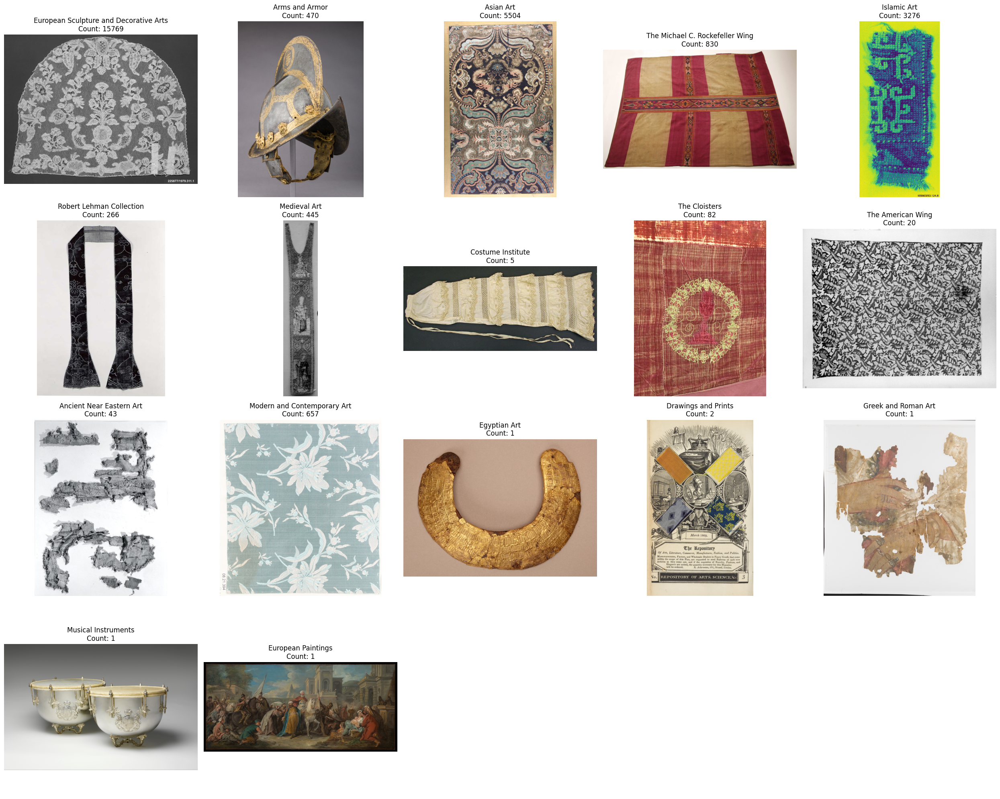

==== IMAGE GRID SUMMARY ====
Total departments: 17
Departments with at least one object with image: 17
Total images directory files: 27361


In [26]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os
import math

images_dir = "MET_TEXTILES_BULLETPROOF_DATASET/images"

departments = df['department'].unique()
dept_counts = df['department'].value_counts()

n_depts = len(departments)
n_cols = math.ceil(math.sqrt(n_depts))
n_rows = math.ceil(n_depts / n_cols)

fig, axes = plt.subplots(n_rows, n_cols, figsize=(5 * n_cols, 5 * n_rows))
axes = axes.flatten()

for idx, (ax, dept) in enumerate(zip(axes, departments)):
    subset = df[(df['department'] == dept) & (df['primaryImage'].apply(bool))]
    if not subset.empty:
        row = subset.iloc[0]
        obj_id = str(row['objectID'])
        file_match = [f for f in os.listdir(images_dir) if f.startswith(obj_id) and '_primary' in f]
        if file_match:
            img_path = os.path.join(images_dir, file_match[0])
            img = mpimg.imread(img_path)
            ax.imshow(img)
        else:
            ax.text(0.5, 0.5, "No image", ha='center', va='center', fontsize=12)
        ax.set_title(f"{dept}\nCount: {dept_counts[dept]}")
        ax.axis('off')
    else:
        ax.text(0.5, 0.5, "No image", ha='center', va='center', fontsize=12)
        ax.set_title(f"{dept}\nCount: 0")
        ax.axis('off')

# Hide any unused subplots
for ax in axes[n_depts:]:
    ax.axis('off')

plt.tight_layout()
plt.show()
print("==== IMAGE GRID SUMMARY ====")
print(f"Total departments: {n_depts}")
print(f"Departments with at least one object with image: {(df.groupby('department')['primaryImage'].apply(lambda x: x.apply(bool).any())).sum()}")
print(f"Total images directory files: {len(os.listdir(images_dir))}")
print("============================")

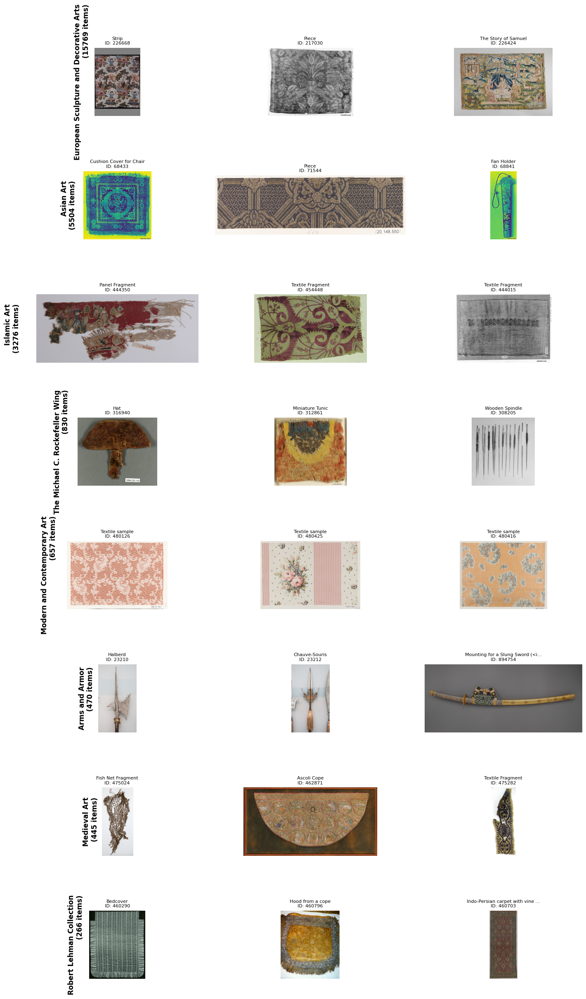

==== DEPARTMENT QUICK REFERENCE ====
European Sculpture and Decorative Arts | Total: 15769 | With Images: 15769 | Coverage: 100.0%
Asian Art                 | Total:  5504 | With Images:  5504 | Coverage: 100.0%
Islamic Art               | Total:  3276 | With Images:  3276 | Coverage: 100.0%
The Michael C. Rockefeller Wing | Total:   830 | With Images:   830 | Coverage: 100.0%
Modern and Contemporary Art | Total:   657 | With Images:   657 | Coverage: 100.0%
Arms and Armor            | Total:   470 | With Images:   470 | Coverage: 100.0%
Medieval Art              | Total:   445 | With Images:   445 | Coverage: 100.0%
Robert Lehman Collection  | Total:   266 | With Images:   266 | Coverage: 100.0%
The Cloisters             | Total:    82 | With Images:    82 | Coverage: 100.0%
Ancient Near Eastern Art  | Total:    43 | With Images:    43 | Coverage: 100.0%
The American Wing         | Total:    20 | With Images:    20 | Coverage: 100.0%
Costume Institute         | Total:     5 | With Ima

In [27]:
# Quick department overview with multiple sample images per department
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os
import random

images_dir = "MET_TEXTILES_BULLETPROOF_DATASET/images"
departments = df['department'].value_counts().index  # Sort by count (largest first)
dept_counts = df['department'].value_counts()

# Show top departments with 3 sample images each
top_depts = departments[:8]  # Show top 8 departments
n_samples = 3

fig, axes = plt.subplots(len(top_depts), n_samples, figsize=(15, 3 * len(top_depts)))

for i, dept in enumerate(top_depts):
    # Get sample objects from this department
    dept_objects = df[(df['department'] == dept) & (df['primaryImage'].apply(bool))]
    
    if len(dept_objects) >= n_samples:
        samples = dept_objects.sample(n_samples)
    else:
        samples = dept_objects
    
    for j in range(n_samples):
        ax = axes[i, j] if len(top_depts) > 1 else axes[j]
        
        if j < len(samples):
            row = samples.iloc[j]
            obj_id = str(row['objectID'])
            title = row['title'][:30] + "..." if len(row['title']) > 30 else row['title']
            
            # Find image file
            file_match = [f for f in os.listdir(images_dir) if f.startswith(obj_id) and '_primary' in f]
            if file_match:
                img_path = os.path.join(images_dir, file_match[0])
                try:
                    img = mpimg.imread(img_path)
                    ax.imshow(img)
                    ax.set_title(f"{title}\nID: {obj_id}", fontsize=8)
                except:
                    ax.text(0.5, 0.5, "Image Error", ha='center', va='center')
                    ax.set_title(f"ID: {obj_id}", fontsize=8)
            else:
                ax.text(0.5, 0.5, "No Image", ha='center', va='center')
                ax.set_title(f"ID: {obj_id}", fontsize=8)
        else:
            ax.text(0.5, 0.5, "No More\nSamples", ha='center', va='center')
            ax.set_title("")
        
        ax.axis('off')
        
        # Add department label on first column
        if j == 0:
            ax.text(-0.1, 0.5, f"{dept}\n({dept_counts[dept]} items)", 
                   rotation=90, va='center', ha='right', fontsize=12, fontweight='bold',
                   transform=ax.transAxes)

plt.tight_layout()
plt.show()

# Print department summary for quick decision making
print("==== DEPARTMENT QUICK REFERENCE ====")
for dept in departments:
    count = dept_counts[dept]
    has_images = df[(df['department'] == dept) & (df['primaryImage'].apply(bool))].shape[0]
    print(f"{dept:25} | Total: {count:5} | With Images: {has_images:5} | Coverage: {has_images/count*100:.1f}%")
print("=====================================")

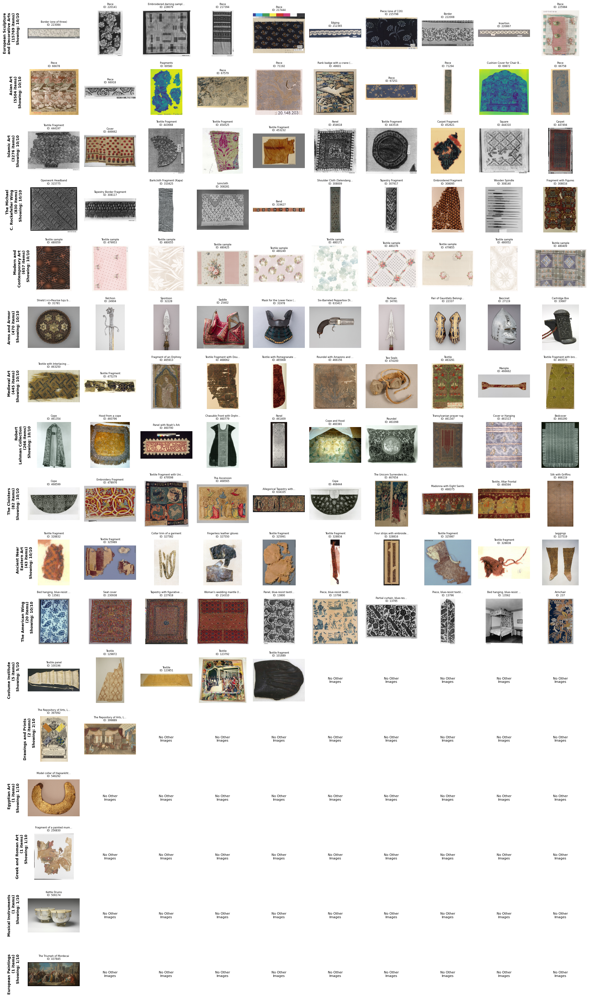

==== VISUALIZATION SUMMARY ====
European Sculpture and Decorative Arts | Total: 15769 | Available: 15769 | Showing: 10/10
Asian Art                           | Total:  5504 | Available:  5504 | Showing: 10/10
Islamic Art                         | Total:  3276 | Available:  3276 | Showing: 10/10
The Michael C. Rockefeller Wing     | Total:   830 | Available:   830 | Showing: 10/10
Modern and Contemporary Art         | Total:   657 | Available:   657 | Showing: 10/10
Arms and Armor                      | Total:   470 | Available:   470 | Showing: 10/10
Medieval Art                        | Total:   445 | Available:   445 | Showing: 10/10
Robert Lehman Collection            | Total:   266 | Available:   266 | Showing: 10/10
The Cloisters                       | Total:    82 | Available:    82 | Showing: 10/10
Ancient Near Eastern Art            | Total:    43 | Available:    43 | Showing: 10/10
The American Wing                   | Total:    20 | Available:    20 | Showing: 10/10
Costume 

In [30]:
# Comprehensive department visualization - show more samples for larger departments
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os
import random

images_dir = "MET_TEXTILES_BULLETPROOF_DATASET/images"
departments = df['department'].value_counts().index  # Sort by count (largest first)
dept_counts = df['department'].value_counts()

# Show ALL departments with 10 samples each
all_depts = departments
max_samples = 10  # Fixed at 10 columns

# Calculate figure height
fig_height = len(all_depts) * 2

fig, axes = plt.subplots(len(all_depts), max_samples, figsize=(max_samples * 2, fig_height))

# Handle single department case
if len(all_depts) == 1:
    axes = axes.reshape(1, -1)

for i, dept in enumerate(all_depts):
    # Get sample objects from this department
    dept_objects = df[(df['department'] == dept) & (df['primaryImage'].apply(bool))]
    
    # Try to get 10 samples, or all available if less than 10
    n_available = len(dept_objects)
    if n_available >= 10:
        samples = dept_objects.sample(10)
    else:
        samples = dept_objects
    
    for j in range(max_samples):
        ax = axes[i, j]
        
        if j < len(samples):
            row = samples.iloc[j]
            obj_id = str(row['objectID'])
            title = row['title'][:25] + "..." if len(row['title']) > 25 else row['title']
            
            # Find image file
            file_match = [f for f in os.listdir(images_dir) if f.startswith(obj_id) and '_primary' in f]
            if file_match:
                img_path = os.path.join(images_dir, file_match[0])
                try:
                    img = mpimg.imread(img_path)
                    ax.imshow(img)
                    ax.set_title(f"{title}\nID: {obj_id}", fontsize=6)
                except:
                    ax.text(0.5, 0.5, "Image Error", ha='center', va='center', fontsize=8)
                    ax.set_title(f"ID: {obj_id}", fontsize=6)
            else:
                ax.text(0.5, 0.5, "No Image", ha='center', va='center', fontsize=8)
                ax.set_title(f"ID: {obj_id}", fontsize=6)
        else:
            ax.text(0.5, 0.5, "No Other\nImages", ha='center', va='center', fontsize=8)
            ax.set_title("", fontsize=6)
        
        ax.axis('off')
        
        # Add department label on first column with line breaks
        if j == 0:
            # Split long department names
            dept_name = dept
            if len(dept_name) > 20:
                words = dept_name.split()
                mid = len(words) // 2
                dept_name = ' '.join(words[:mid]) + '\n' + ' '.join(words[mid:])
            
            ax.text(-0.15, 0.5, f"{dept_name}\n({dept_counts[dept]} items)\nShowing: {len(samples)}/10", 
                   rotation=90, va='center', ha='right', fontsize=9, fontweight='bold',
                   transform=ax.transAxes)

plt.tight_layout()
plt.show()

# Summary
print("==== VISUALIZATION SUMMARY ====")
for dept in all_depts:
    count = dept_counts[dept]
    dept_objects = df[(df['department'] == dept) & (df['primaryImage'].apply(bool))]
    available = len(dept_objects)
    shown = min(10, available)
    print(f"{dept:35} | Total: {count:5} | Available: {available:5} | Showing: {shown:2}/10")
print("===============================")

🕐 Analyzing Time Periods (Dynamic)...
📅 Date range in dataset: -2000 - 1990 (3990 years)


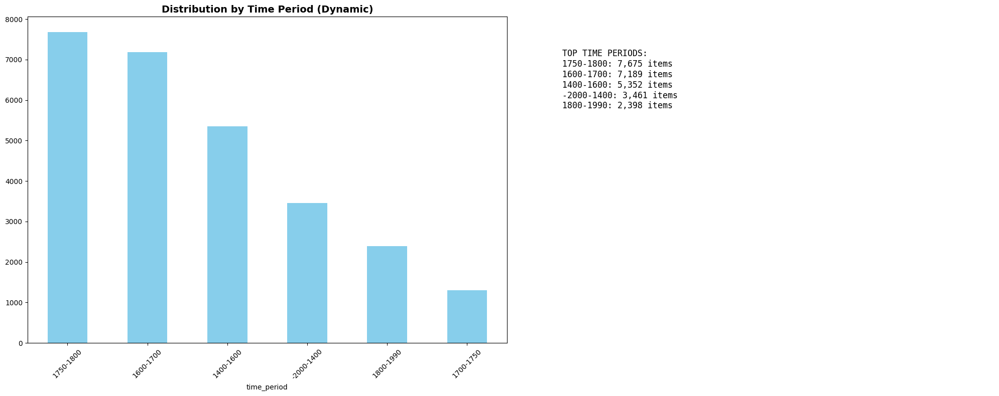


🧵 Analyzing Medium Categories (Dynamic)...
🔍 Top medium keywords found: ['silk', 'thread', 'linen', 'weave', 'lace', 'wool', 'metal', 'cotton', 'bobbin', 'tapestry']


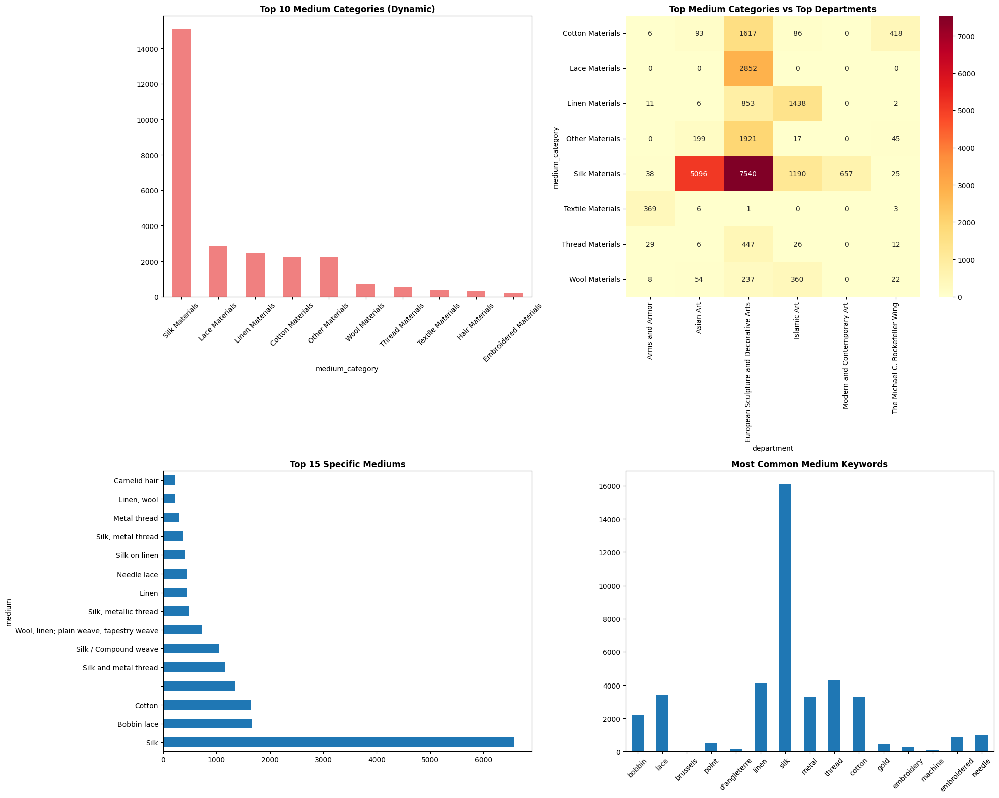


👕 Analyzing Object Types (Dynamic)...
🏺 Common object name keywords: ['piece', 'fragment', 'textile', 'sample', 'border', 'panel', 'sampler', 'ribbon', 'cover', 'galloon', 'band', 'strip', 'carpet', 'edging', 'tapestry']


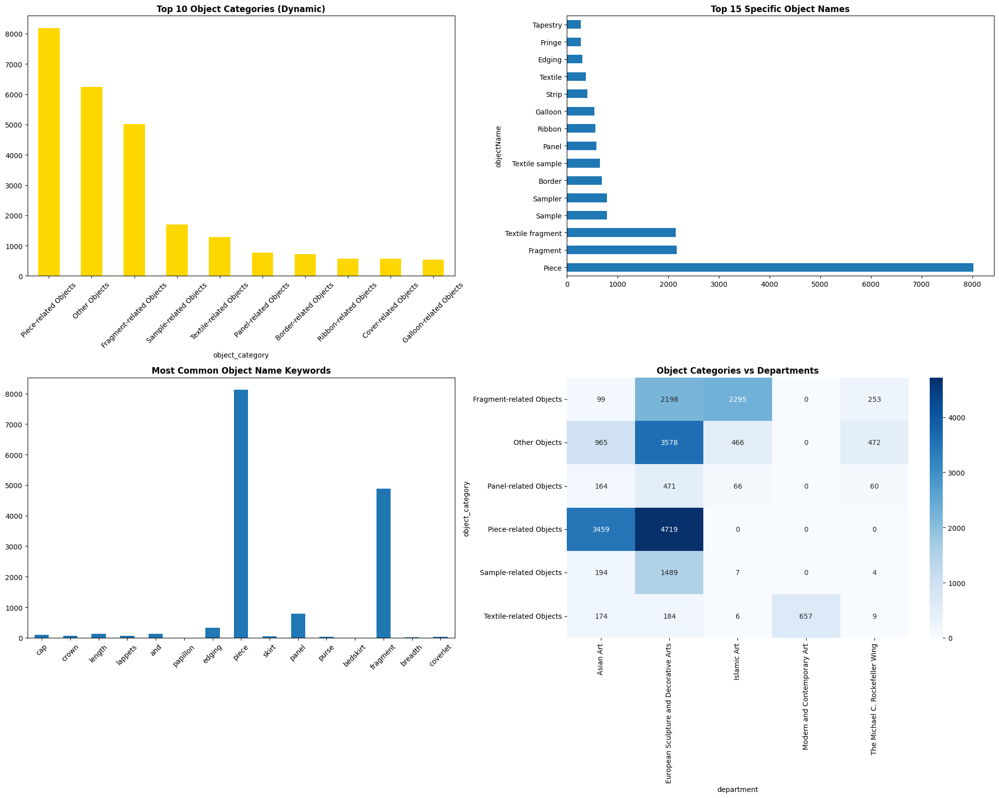


🌍 Analyzing Geographic Origins (Dynamic)...
🌍 Common geographic terms: ['others', 'japan', 'egypt', 'china', 'peru', 'iran', 'turkey', 'italian', 'india', 'byzantine', 'italy', 'peruvian', 'coptic', 'south', 'spanish']


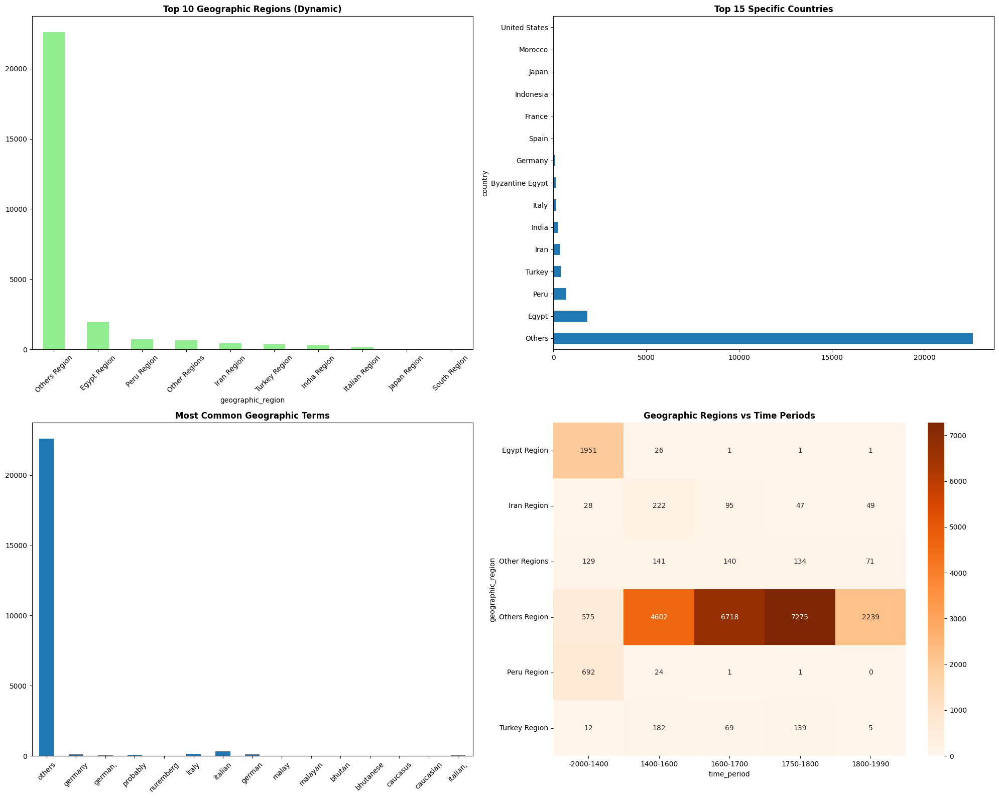


📊 DYNAMIC FILTERING STRATEGY RECOMMENDATIONS
🕐 TIME: Focus on 1750-1800 (7,675 items)
🧵 MEDIUM: Focus on Silk Materials (15,081 items)
👕 OBJECTS: Focus on Piece-related Objects (8,181 items)
🌍 REGIONS: Focus on Others Region (22,603 items)

💡 SUGGESTED FILTERING WORKFLOW:
1. Start with largest category from above
2. Cross-filter with 2nd largest category
3. Visual review of resulting subset
4. Iterate with different combinations


In [42]:
# Advanced categorization and filtering visualizations - DYNAMIC VERSION
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from collections import Counter
import seaborn as sns

def analyze_time_periods_dynamic():
    """Dynamically categorize by historical periods based on actual data distribution"""
    
    # Clean dates
    df['objectBeginDate'] = pd.to_numeric(df['objectBeginDate'], errors='coerce')
    df['objectEndDate'] = pd.to_numeric(df['objectEndDate'], errors='coerce')
    
    # Get actual date range from data
    valid_dates = df['objectBeginDate'].dropna()
    if len(valid_dates) == 0:
        print("No valid dates found")
        return
    
    min_date = int(valid_dates.min())
    max_date = int(valid_dates.max())
    date_range = max_date - min_date
    
    print(f"📅 Date range in dataset: {min_date} - {max_date} ({date_range} years)")
    
    # Dynamic period creation based on data distribution
    def create_dynamic_periods(dates, n_periods=8):
        # Use quantiles to create roughly equal-sized periods
        quantiles = np.linspace(0, 1, n_periods + 1)
        period_boundaries = dates.quantile(quantiles).astype(int).tolist()
        
        periods = []
        for i in range(len(period_boundaries) - 1):
            start = period_boundaries[i]
            end = period_boundaries[i + 1]
            periods.append((start, end, f"{start}-{end}"))
        
        return periods
    
    periods = create_dynamic_periods(valid_dates)
    
    def categorize_period_dynamic(date):
        if pd.isna(date):
            return "Unknown Date"
        
        for start, end, label in periods:
            if start <= date <= end:
                return label
        return "Outside Range"
    
    df['time_period'] = df['objectBeginDate'].apply(categorize_period_dynamic)
    
    # Visualize
    period_counts = df['time_period'].value_counts()
    
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 8))
    
    period_counts.plot(kind='bar', ax=ax1, color='skyblue')
    ax1.set_title('Distribution by Time Period (Dynamic)', fontsize=14, fontweight='bold')
    ax1.tick_params(axis='x', rotation=45)
    
    # Show top periods
    top_periods = period_counts.head(5)
    summary_text = "TOP TIME PERIODS:\n" + "\n".join([f"{p}: {count:,} items" for p, count in top_periods.items()])
    ax2.text(0.1, 0.9, summary_text, transform=ax2.transAxes, fontsize=12, 
             verticalalignment='top', fontfamily='monospace')
    ax2.axis('off')
    
    plt.tight_layout()
    plt.show()
    
    return period_counts

def analyze_medium_categories_dynamic():
    """Dynamically categorize mediums based on frequency and keywords"""
    
    # Get all unique medium values
    all_mediums = df['medium'].dropna().str.lower()
    
    # Extract most common keywords
    all_words = []
    for medium in all_mediums:
        words = str(medium).replace(',', ' ').replace(';', ' ').split()
        all_words.extend([w.strip() for w in words if len(w) > 3])  # Only words longer than 3 chars
    
    word_freq = Counter(all_words)
    top_keywords = [word for word, count in word_freq.most_common(20)]
    
    print(f"🔍 Top medium keywords found: {top_keywords[:10]}")
    
    def categorize_medium_dynamic(medium_str):
        if pd.isna(medium_str):
            return "Unknown Medium"
        
        medium_lower = str(medium_str).lower()
        
        # Dynamic categorization based on most frequent keywords
        for keyword in top_keywords:
            if keyword in medium_lower:
                return f"{keyword.title()} Materials"
        
        return "Other Materials"
    
    df['medium_category'] = df['medium'].apply(categorize_medium_dynamic)
    
    # Visualize
    medium_counts = df['medium_category'].value_counts()
    
    fig, axes = plt.subplots(2, 2, figsize=(20, 16))
    
    # Distribution
    medium_counts.head(10).plot(kind='bar', ax=axes[0,0], color='lightcoral')
    axes[0,0].set_title('Top 10 Medium Categories (Dynamic)', fontweight='bold')
    axes[0,0].tick_params(axis='x', rotation=45)
    
    # Heatmap with departments
    top_mediums = medium_counts.head(8).index
    top_depts = df['department'].value_counts().head(6).index
    
    filtered_df = df[df['medium_category'].isin(top_mediums) & df['department'].isin(top_depts)]
    crosstab = pd.crosstab(filtered_df['medium_category'], filtered_df['department'])
    
    sns.heatmap(crosstab, annot=True, fmt='d', ax=axes[0,1], cmap='YlOrRd')
    axes[0,1].set_title('Top Medium Categories vs Top Departments', fontweight='bold')
    
    # Most specific mediums
    df['medium'].value_counts().head(15).plot(kind='barh', ax=axes[1,0])
    axes[1,0].set_title('Top 15 Specific Mediums', fontweight='bold')
    
    # Keywords frequency
    pd.Series(word_freq).head(15).plot(kind='bar', ax=axes[1,1])
    axes[1,1].set_title('Most Common Medium Keywords', fontweight='bold')
    axes[1,1].tick_params(axis='x', rotation=45)
    
    plt.tight_layout()
    plt.show()
    
    return medium_counts

def analyze_object_names_dynamic():
    """Dynamically categorize object names based on frequency patterns"""
    
    # Get most common object names and extract patterns
    object_counts = df['objectName'].value_counts()
    top_objects = object_counts.head(20).index
    
    # Extract common words from object names
    all_obj_words = []
    for obj_name in df['objectName'].dropna():
        words = str(obj_name).lower().split()
        all_obj_words.extend([w.strip() for w in words if len(w) > 2])
    
    obj_word_freq = Counter(all_obj_words)
    common_obj_words = [word for word, count in obj_word_freq.most_common(15)]
    
    print(f"🏺 Common object name keywords: {common_obj_words}")
    
    def categorize_object_dynamic(obj_name):
        if pd.isna(obj_name):
            return "Unknown Object"
        
        name_lower = str(obj_name).lower()
        
        # Group by most common keywords found in data
        for keyword in common_obj_words:
            if keyword in name_lower:
                return f"{keyword.title()}-related Objects"
        
        return "Other Objects"
    
    df['object_category'] = df['objectName'].apply(categorize_object_dynamic)
    
    # Visualize
    obj_counts = df['object_category'].value_counts()
    
    fig, axes = plt.subplots(2, 2, figsize=(20, 16))
    
    # Category distribution
    obj_counts.head(10).plot(kind='bar', ax=axes[0,0], color='gold')
    axes[0,0].set_title('Top 10 Object Categories (Dynamic)', fontweight='bold')
    axes[0,0].tick_params(axis='x', rotation=45)
    
    # Most specific object names
    object_counts.head(15).plot(kind='barh', ax=axes[0,1])
    axes[0,1].set_title('Top 15 Specific Object Names', fontweight='bold')
    
    # Object keywords frequency
    pd.Series(obj_word_freq).head(15).plot(kind='bar', ax=axes[1,0])
    axes[1,0].set_title('Most Common Object Name Keywords', fontweight='bold')
    axes[1,0].tick_params(axis='x', rotation=45)
    
    # Cross-analysis with top categories
    if len(obj_counts) > 1:
        top_obj_cats = obj_counts.head(6).index
        top_depts = df['department'].value_counts().head(5).index
        
        filtered_df = df[df['object_category'].isin(top_obj_cats) & df['department'].isin(top_depts)]
        if not filtered_df.empty:
            crosstab = pd.crosstab(filtered_df['object_category'], filtered_df['department'])
            sns.heatmap(crosstab, annot=True, fmt='d', ax=axes[1,1], cmap='Blues')
            axes[1,1].set_title('Object Categories vs Departments', fontweight='bold')
        else:
            axes[1,1].text(0.5, 0.5, 'No data for cross-analysis', ha='center', va='center')
    
    plt.tight_layout()
    plt.show()
    
    return obj_counts

def analyze_geographic_origin_dynamic():
    """Dynamically categorize geographic origins based on actual data"""
    
    # Combine country and culture info
    df['combined_geo'] = df['country'].fillna('') + ' ' + df['culture'].fillna('')
    df['combined_geo'] = df['combined_geo'].str.strip()
    
    # Find most common geographic terms
    geo_words = []
    for geo_info in df['combined_geo']:
        if pd.notna(geo_info) and geo_info.strip():
            words = str(geo_info).lower().split()
            geo_words.extend([w.strip() for w in words if len(w) > 3])
    
    geo_word_freq = Counter(geo_words)
    common_geo_terms = [word for word, count in geo_word_freq.most_common(15)]
    
    print(f"🌍 Common geographic terms: {common_geo_terms}")
    
    def categorize_geography_dynamic(combined_geo):
        if pd.isna(combined_geo) or not str(combined_geo).strip():
            return "Unknown Origin"
        
        geo_lower = str(combined_geo).lower()
        
        # Group by most common geographic terms found in data
        for term in common_geo_terms:
            if term in geo_lower:
                return f"{term.title()} Region"
        
        return "Other Regions"
    
    df['geographic_region'] = df['combined_geo'].apply(categorize_geography_dynamic)
    
    # Visualize
    geo_counts = df['geographic_region'].value_counts()
    
    fig, axes = plt.subplots(2, 2, figsize=(20, 16))
    
    # Geographic distribution
    geo_counts.head(10).plot(kind='bar', ax=axes[0,0], color='lightgreen')
    axes[0,0].set_title('Top 10 Geographic Regions (Dynamic)', fontweight='bold')
    axes[0,0].tick_params(axis='x', rotation=45)
    
    # Specific countries
    df['country'].replace('', 'Unknown').fillna('Unknown').value_counts().head(15).plot(kind='barh', ax=axes[0,1])
    axes[0,1].set_title('Top 15 Specific Countries', fontweight='bold')
    
    # Geographic terms frequency
    pd.Series(geo_word_freq).head(15).plot(kind='bar', ax=axes[1,0])
    axes[1,0].set_title('Most Common Geographic Terms', fontweight='bold')
    axes[1,0].tick_params(axis='x', rotation=45)
    
    # Cross-analysis if data available
    if len(geo_counts) > 1:
        top_geo_regions = geo_counts.head(6).index
        if 'time_period' in df.columns:
            top_periods = df['time_period'].value_counts().head(5).index
            filtered_df = df[df['geographic_region'].isin(top_geo_regions) & df['time_period'].isin(top_periods)]
            if not filtered_df.empty:
                crosstab = pd.crosstab(filtered_df['geographic_region'], filtered_df['time_period'])
                sns.heatmap(crosstab, annot=True, fmt='d', ax=axes[1,1], cmap='Oranges')
                axes[1,1].set_title('Geographic Regions vs Time Periods', fontweight='bold')
            else:
                axes[1,1].text(0.5, 0.5, 'No time period data', ha='center', va='center')
        else:
            axes[1,1].text(0.5, 0.5, 'Run time analysis first', ha='center', va='center')
    
    plt.tight_layout()
    plt.show()
    
    return geo_counts

# Run all dynamic analyses
print("🕐 Analyzing Time Periods (Dynamic)...")
period_analysis = analyze_time_periods_dynamic()

print("\n🧵 Analyzing Medium Categories (Dynamic)...")
medium_analysis = analyze_medium_categories_dynamic()

print("\n👕 Analyzing Object Types (Dynamic)...")
object_analysis = analyze_object_names_dynamic()

print("\n🌍 Analyzing Geographic Origins (Dynamic)...")
geo_analysis = analyze_geographic_origin_dynamic()

# Dynamic summary
print("\n" + "="*80)
print("📊 DYNAMIC FILTERING STRATEGY RECOMMENDATIONS")
print("="*80)

if len(period_analysis) > 0:
    print(f"🕐 TIME: Focus on {period_analysis.index[0]} ({period_analysis.iloc[0]:,} items)")

if len(medium_analysis) > 0:
    print(f"🧵 MEDIUM: Focus on {medium_analysis.index[0]} ({medium_analysis.iloc[0]:,} items)")

if len(object_analysis) > 0:
    print(f"👕 OBJECTS: Focus on {object_analysis.index[0]} ({object_analysis.iloc[0]:,} items)")

if len(geo_analysis) > 0:
    print(f"🌍 REGIONS: Focus on {geo_analysis.index[0]} ({geo_analysis.iloc[0]:,} items)")

print("\n💡 SUGGESTED FILTERING WORKFLOW:")
print("1. Start with largest category from above")
print("2. Cross-filter with 2nd largest category")
print("3. Visual review of resulting subset")
print("4. Iterate with different combinations")

🕐 Running dynamic analysis to create categories...
✅ Categories created! Now generating visual grids...

📅 TIME PERIODS - Visual Grid
🎨 Creating Time Periods visualization...


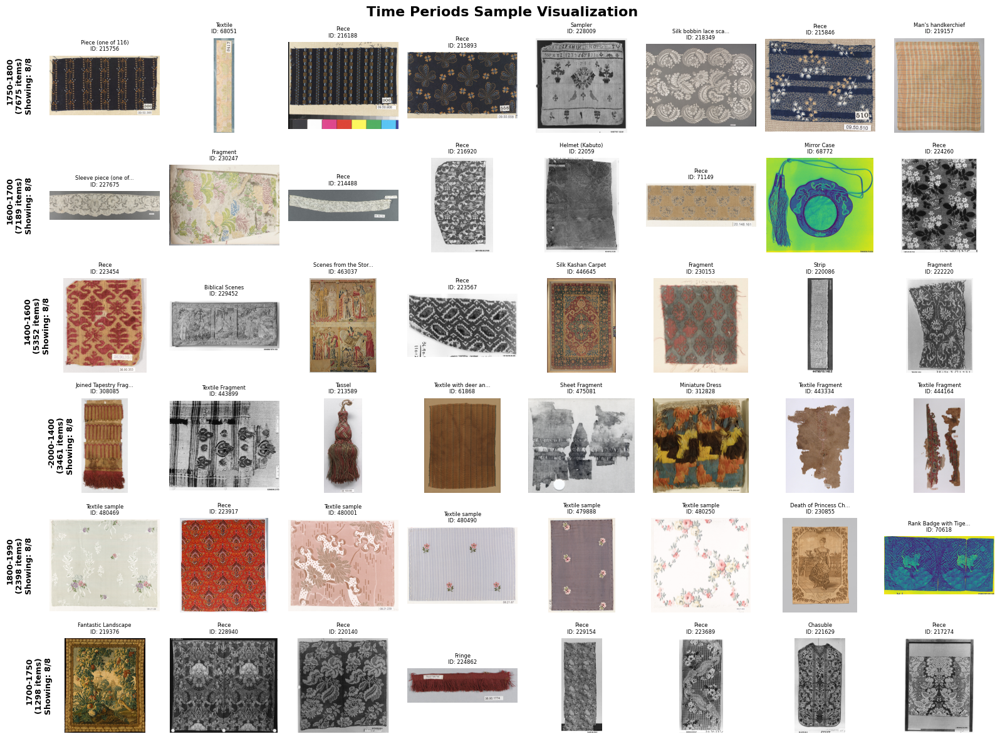

Saved: category_visualizations/time_periods_grid.png
==== TIME PERIODS VISUALIZATION SUMMARY ====
1750-1800                                | Total:  7675 | Available:  7675 | Showing:  8/8
1600-1700                                | Total:  7189 | Available:  7189 | Showing:  8/8
1400-1600                                | Total:  5352 | Available:  5352 | Showing:  8/8
-2000-1400                               | Total:  3461 | Available:  3461 | Showing:  8/8
1800-1990                                | Total:  2398 | Available:  2398 | Showing:  8/8
1700-1750                                | Total:  1298 | Available:  1298 | Showing:  8/8

🧵 MEDIUM CATEGORIES - Visual Grid
🎨 Creating Medium Categories visualization...


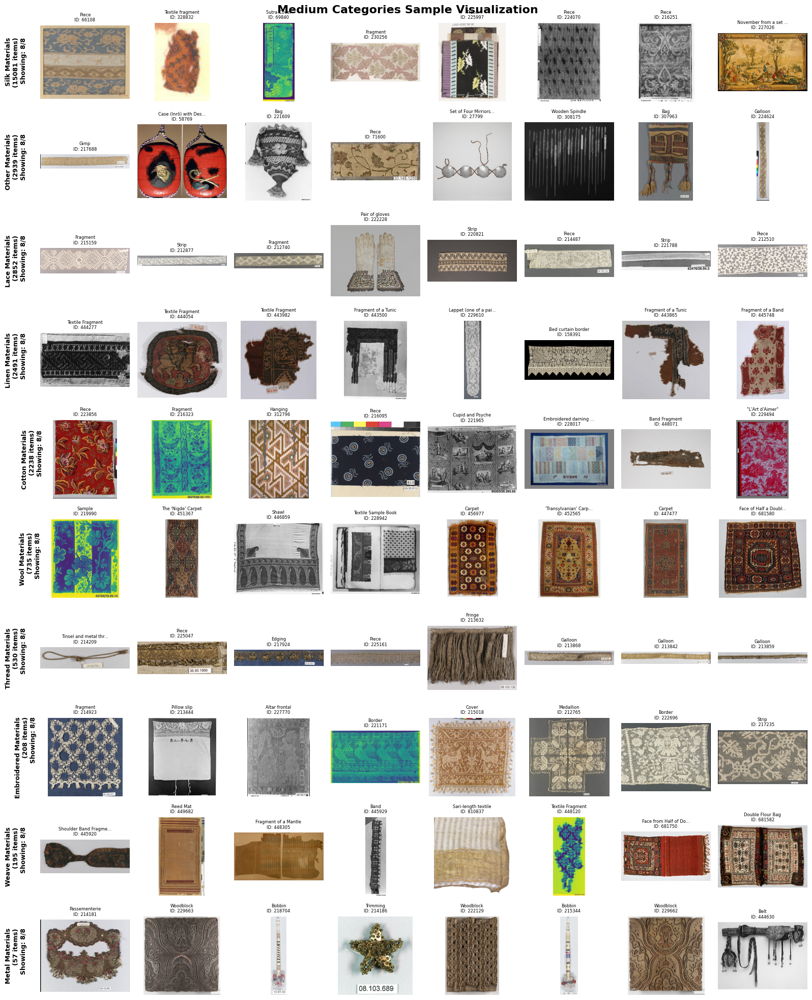

Saved: category_visualizations/medium_categories_grid.png
==== MEDIUM CATEGORIES VISUALIZATION SUMMARY ====
Silk Materials                           | Total: 15081 | Available: 15081 | Showing:  8/8
Other Materials                          | Total:  2939 | Available:  2939 | Showing:  8/8
Lace Materials                           | Total:  2852 | Available:  2852 | Showing:  8/8
Linen Materials                          | Total:  2491 | Available:  2491 | Showing:  8/8
Cotton Materials                         | Total:  2238 | Available:  2238 | Showing:  8/8
Wool Materials                           | Total:   735 | Available:   735 | Showing:  8/8
Thread Materials                         | Total:   530 | Available:   530 | Showing:  8/8
Embroidered Materials                    | Total:   208 | Available:   208 | Showing:  8/8
Weave Materials                          | Total:   195 | Available:   195 | Showing:  8/8
Metal Materials                          | Total:    57 | Available:    5

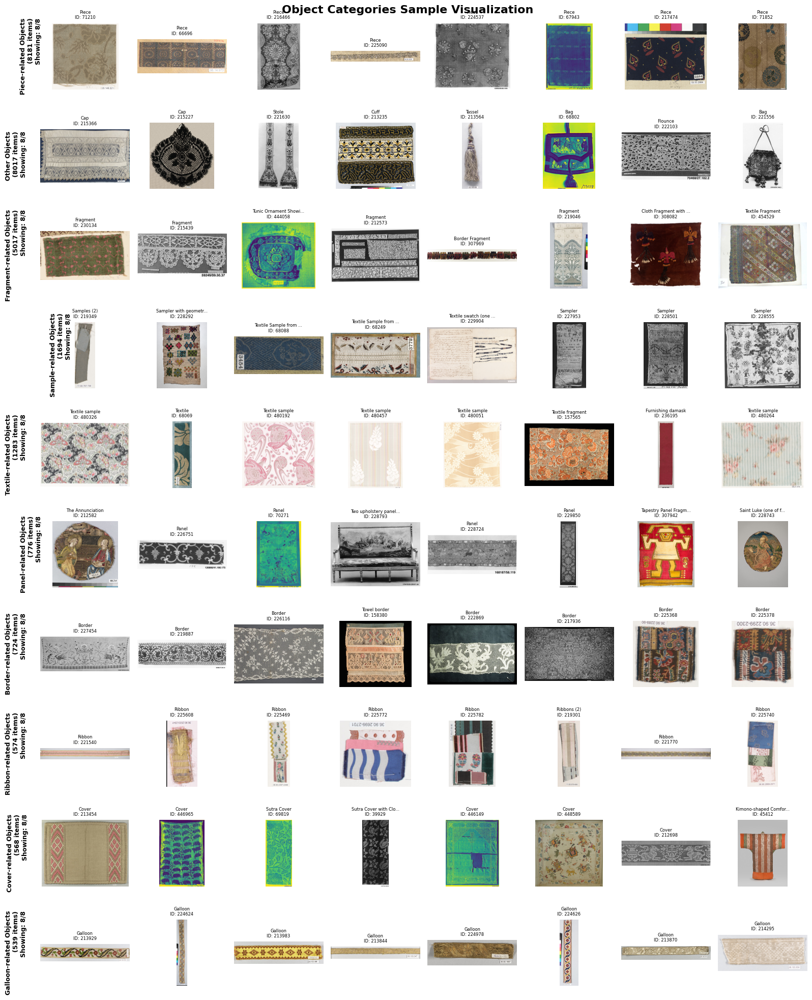

Saved: category_visualizations/object_categories_grid.png
==== OBJECT CATEGORIES VISUALIZATION SUMMARY ====
Piece-related Objects                    | Total:  8181 | Available:  8181 | Showing:  8/8
Other Objects                            | Total:  8017 | Available:  8017 | Showing:  8/8
Fragment-related Objects                 | Total:  5017 | Available:  5017 | Showing:  8/8
Sample-related Objects                   | Total:  1694 | Available:  1694 | Showing:  8/8
Textile-related Objects                  | Total:  1283 | Available:  1283 | Showing:  8/8
Panel-related Objects                    | Total:   776 | Available:   776 | Showing:  8/8
Border-related Objects                   | Total:   724 | Available:   724 | Showing:  8/8
Ribbon-related Objects                   | Total:   574 | Available:   574 | Showing:  8/8
Cover-related Objects                    | Total:   568 | Available:   568 | Showing:  8/8
Galloon-related Objects                  | Total:   539 | Available:   53

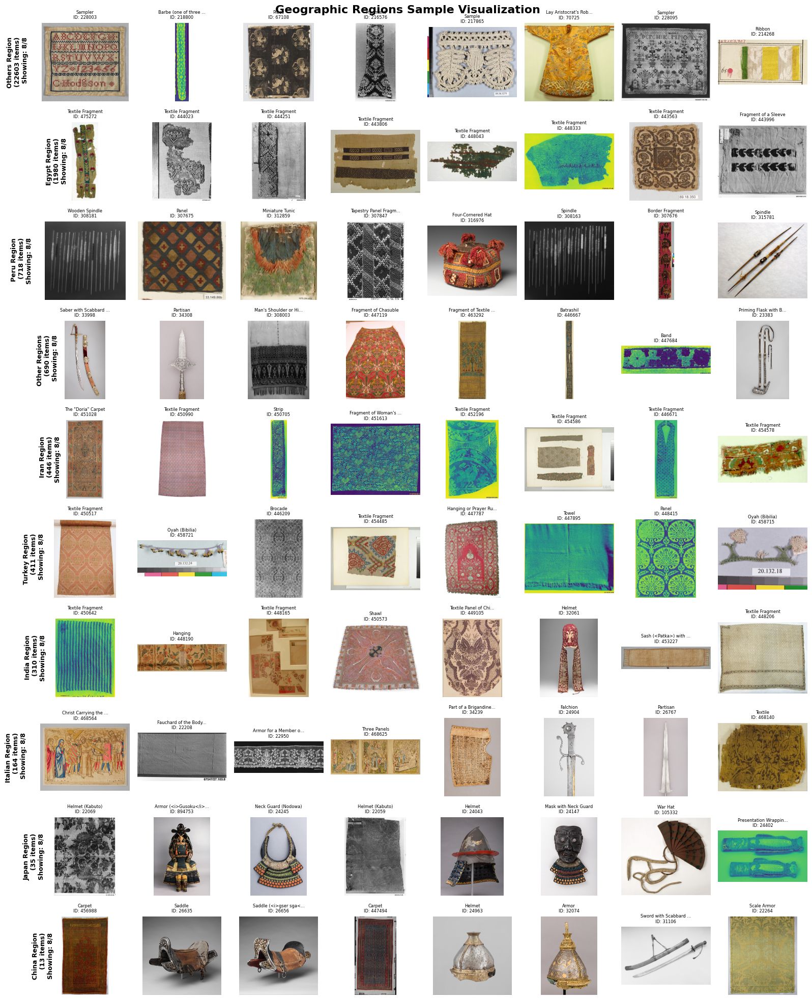

Saved: category_visualizations/geographic_regions_grid.png
==== GEOGRAPHIC REGIONS VISUALIZATION SUMMARY ====
Others Region                            | Total: 22603 | Available: 22603 | Showing:  8/8
Egypt Region                             | Total:  1980 | Available:  1980 | Showing:  8/8
Peru Region                              | Total:   718 | Available:   718 | Showing:  8/8
Other Regions                            | Total:   690 | Available:   690 | Showing:  8/8
Iran Region                              | Total:   446 | Available:   446 | Showing:  8/8
Turkey Region                            | Total:   411 | Available:   411 | Showing:  8/8
India Region                             | Total:   310 | Available:   310 | Showing:  8/8
Italian Region                           | Total:   164 | Available:   164 | Showing:  8/8
Japan Region                             | Total:    35 | Available:    35 | Showing:  8/8
China Region                             | Total:    13 | Available:   

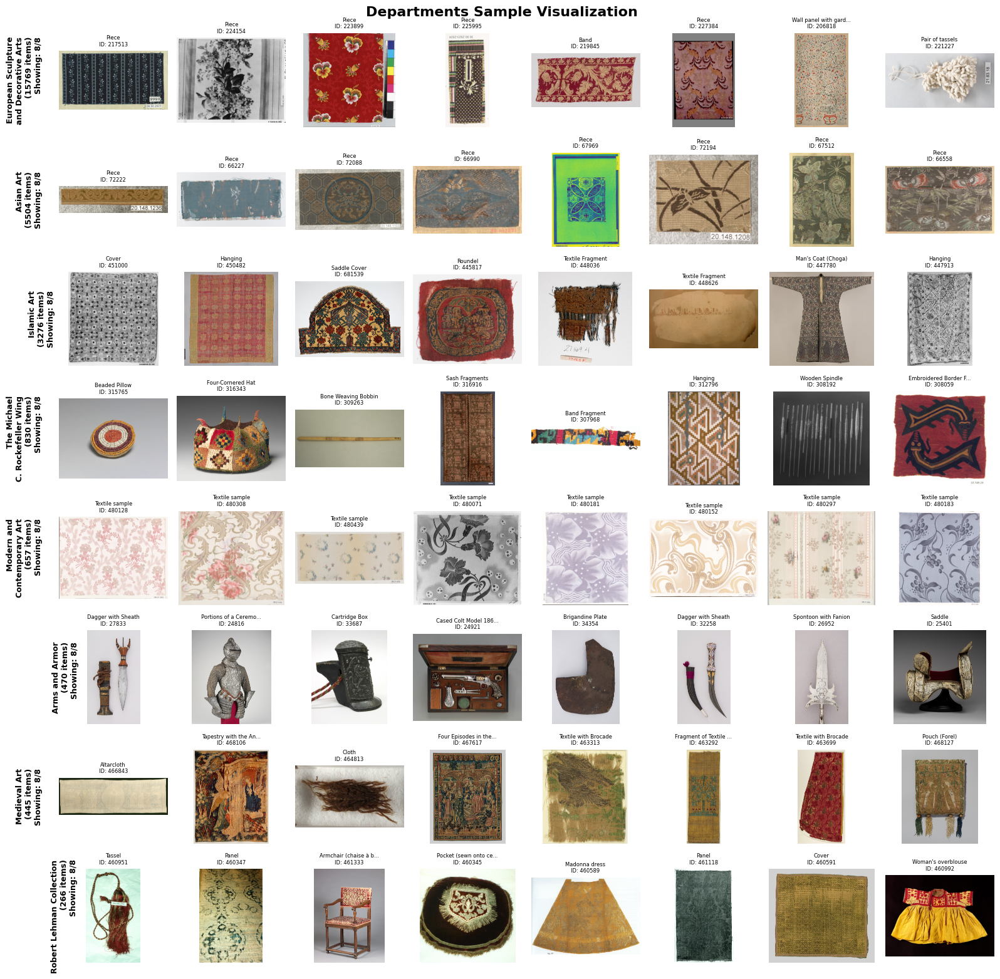

Saved: category_visualizations/departments_grid.png
==== DEPARTMENTS VISUALIZATION SUMMARY ====
European Sculpture and Decorative Arts   | Total: 15769 | Available: 15769 | Showing:  8/8
Asian Art                                | Total:  5504 | Available:  5504 | Showing:  8/8
Islamic Art                              | Total:  3276 | Available:  3276 | Showing:  8/8
The Michael C. Rockefeller Wing          | Total:   830 | Available:   830 | Showing:  8/8
Modern and Contemporary Art              | Total:   657 | Available:   657 | Showing:  8/8
Arms and Armor                           | Total:   470 | Available:   470 | Showing:  8/8
Medieval Art                             | Total:   445 | Available:   445 | Showing:  8/8
Robert Lehman Collection                 | Total:   266 | Available:   266 | Showing:  8/8

🏷️ CLASSIFICATIONS - Visual Grid
🎨 Creating Classifications visualization...


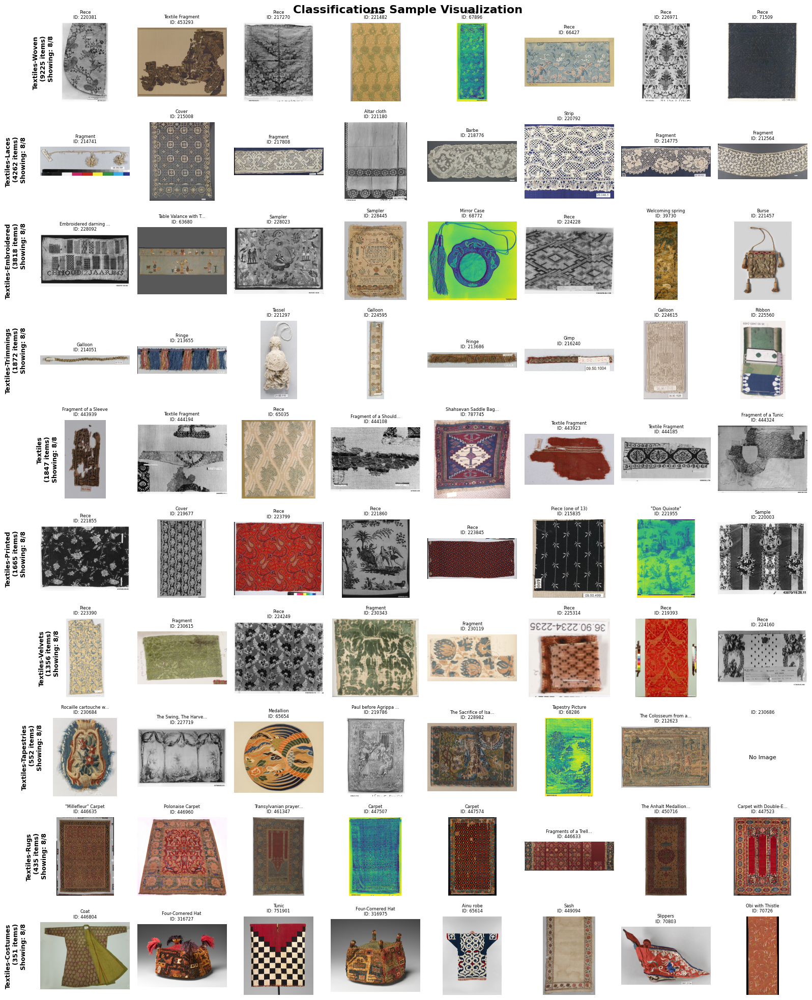

Saved: category_visualizations/classifications_grid.png
==== CLASSIFICATIONS VISUALIZATION SUMMARY ====
Textiles-Woven                           | Total:  9225 | Available:  9225 | Showing:  8/8
Textiles-Laces                           | Total:  4262 | Available:  4262 | Showing:  8/8
Textiles-Embroidered                     | Total:  3818 | Available:  3818 | Showing:  8/8
Textiles-Trimmings                       | Total:  1872 | Available:  1872 | Showing:  8/8
Textiles                                 | Total:  1847 | Available:  1847 | Showing:  8/8
Textiles-Printed                         | Total:  1665 | Available:  1665 | Showing:  8/8
Textiles-Velvets                         | Total:  1356 | Available:  1356 | Showing:  8/8
Textiles-Tapestries                      | Total:   552 | Available:   552 | Showing:  8/8
Textiles-Rugs                            | Total:   435 | Available:   435 | Showing:  8/8
Textiles-Costumes                        | Total:   351 | Available:   351 | 

In [43]:
def visualize_category_samples(category_column, category_name, max_samples=10, max_categories=None):
    """Create visual grid showing sample images for each category"""
    
    import matplotlib.pyplot as plt
    import matplotlib.image as mpimg
    import os
    
    images_dir = "MET_TEXTILES_BULLETPROOF_DATASET/images"
    
    # Get category counts, sorted by frequency
    category_counts = df[category_column].value_counts()
    
    # Limit categories if specified
    if max_categories:
        categories = category_counts.head(max_categories).index
    else:
        categories = category_counts.index
    
    # Calculate figure dimensions
    fig_height = len(categories) * 2
    fig_width = max_samples * 2
    
    fig, axes = plt.subplots(len(categories), max_samples, figsize=(fig_width, fig_height))
    
    # Handle single category case
    if len(categories) == 1:
        axes = axes.reshape(1, -1)
    elif max_samples == 1:
        axes = axes.reshape(-1, 1)
    
    print(f"🎨 Creating {category_name} visualization...")
    
    for i, category in enumerate(categories):
        # Get sample objects from this category with images
        category_objects = df[(df[category_column] == category) & (df['primaryImage'].apply(bool))]
        
        # Try to get max_samples, or all available if less
        n_available = len(category_objects)
        if n_available >= max_samples:
            samples = category_objects.sample(max_samples)
        else:
            samples = category_objects
        
        for j in range(max_samples):
            if len(categories) == 1:
                ax = axes[j]
            else:
                ax = axes[i, j]
            
            if j < len(samples):
                row = samples.iloc[j]
                obj_id = str(row['objectID'])
                title = row['title'][:20] + "..." if len(row['title']) > 20 else row['title']
                
                # Find image file
                file_match = [f for f in os.listdir(images_dir) if f.startswith(obj_id) and '_primary' in f]
                if file_match:
                    img_path = os.path.join(images_dir, file_match[0])
                    try:
                        img = mpimg.imread(img_path)
                        ax.imshow(img)
                        ax.set_title(f"{title}\nID: {obj_id}", fontsize=6)
                    except:
                        ax.text(0.5, 0.5, "Image Error", ha='center', va='center', fontsize=8)
                        ax.set_title(f"ID: {obj_id}", fontsize=6)
                else:
                    ax.text(0.5, 0.5, "No Image", ha='center', va='center', fontsize=8)
                    ax.set_title(f"ID: {obj_id}", fontsize=6)
            else:
                ax.text(0.5, 0.5, "No More\nSamples", ha='center', va='center', fontsize=8)
                ax.set_title("", fontsize=6)
            
            ax.axis('off')
            
            # Add category label on first column
            if j == 0:
                # Handle long category names
                cat_name = str(category)
                if len(cat_name) > 25:
                    words = cat_name.split()
                    if len(words) > 1:
                        mid = len(words) // 2
                        cat_name = ' '.join(words[:mid]) + '\n' + ' '.join(words[mid:])
                    else:
                        cat_name = cat_name[:25] + "..."
                
                ax.text(-0.15, 0.5, f"{cat_name}\n({category_counts[category]} items)\nShowing: {len(samples)}/{max_samples}", 
                       rotation=90, va='center', ha='right', fontsize=9, fontweight='bold',
                       transform=ax.transAxes)
    
    plt.suptitle(f'{category_name} Sample Visualization', fontsize=16, fontweight='bold', y=0.98)
    plt.tight_layout()
    plt.show()
    
    # Save figure to disk
    output_dir = "category_visualizations"
    os.makedirs(output_dir, exist_ok=True)
    fig_path = os.path.join(output_dir, f"{category_name.replace(' ', '_').lower()}_grid.png")
    fig.savefig(fig_path, dpi=200, bbox_inches='tight')
    print(f"Saved: {fig_path}")

    # Print summary
    print(f"==== {category_name.upper()} VISUALIZATION SUMMARY ====")
    for category in categories:
        count = category_counts[category]
        category_objects = df[(df[category_column] == category) & (df['primaryImage'].apply(bool))]
        available = len(category_objects)
        shown = min(max_samples, available)
        print(f"{str(category)[:40]:40} | Total: {count:5} | Available: {available:5} | Showing: {shown:2}/{max_samples}")
    print("=" * 80)

# First run your dynamic analysis to create the categories
print("🕐 Running dynamic analysis to create categories...")

# Time periods
df['objectBeginDate'] = pd.to_numeric(df['objectBeginDate'], errors='coerce')
valid_dates = df['objectBeginDate'].dropna()
if len(valid_dates) > 0:
    quantiles = np.linspace(0, 1, 9)  # 8 periods
    period_boundaries = valid_dates.quantile(quantiles).astype(int).tolist()
    
    def categorize_period_dynamic(date):
        if pd.isna(date):
            return "Unknown Date"
        for i in range(len(period_boundaries) - 1):
            if period_boundaries[i] <= date <= period_boundaries[i + 1]:
                return f"{period_boundaries[i]}-{period_boundaries[i + 1]}"
        return "Outside Range"
    
    df['time_period'] = df['objectBeginDate'].apply(categorize_period_dynamic)

# Medium categories
all_mediums = df['medium'].dropna().str.lower()
all_words = []
for medium in all_mediums:
    words = str(medium).replace(',', ' ').replace(';', ' ').split()
    all_words.extend([w.strip() for w in words if len(w) > 3])

word_freq = Counter(all_words)
top_keywords = [word for word, count in word_freq.most_common(15)]

def categorize_medium_dynamic(medium_str):
    if pd.isna(medium_str):
        return "Unknown Medium"
    medium_lower = str(medium_str).lower()
    for keyword in top_keywords:
        if keyword in medium_lower:
            return f"{keyword.title()} Materials"
    return "Other Materials"

df['medium_category'] = df['medium'].apply(categorize_medium_dynamic)

# Object categories
all_obj_words = []
for obj_name in df['objectName'].dropna():
    words = str(obj_name).lower().split()
    all_obj_words.extend([w.strip() for w in words if len(w) > 2])

obj_word_freq = Counter(all_obj_words)
common_obj_words = [word for word, count in obj_word_freq.most_common(10)]

def categorize_object_dynamic(obj_name):
    if pd.isna(obj_name):
        return "Unknown Object"
    name_lower = str(obj_name).lower()
    for keyword in common_obj_words:
        if keyword in name_lower:
            return f"{keyword.title()}-related Objects"
    return "Other Objects"

df['object_category'] = df['objectName'].apply(categorize_object_dynamic)

# Geographic regions
df['combined_geo'] = df['country'].fillna('') + ' ' + df['culture'].fillna('')
df['combined_geo'] = df['combined_geo'].str.strip()

geo_words = []
for geo_info in df['combined_geo']:
    if pd.notna(geo_info) and geo_info.strip():
        words = str(geo_info).lower().split()
        geo_words.extend([w.strip() for w in words if len(w) > 3])

geo_word_freq = Counter(geo_words)
common_geo_terms = [word for word, count in geo_word_freq.most_common(10)]

def categorize_geography_dynamic(combined_geo):
    if pd.isna(combined_geo) or not str(combined_geo).strip():
        return "Unknown Origin"
    geo_lower = str(combined_geo).lower()
    for term in common_geo_terms:
        if term in geo_lower:
            return f"{term.title()} Region"
    return "Other Regions"

df['geographic_region'] = df['combined_geo'].apply(categorize_geography_dynamic)

print("✅ Categories created! Now generating visual grids...\n")

# Now create visual grids for each category
print("📅 TIME PERIODS - Visual Grid")
visualize_category_samples('time_period', 'Time Periods', max_samples=8, max_categories=8)

print("\n🧵 MEDIUM CATEGORIES - Visual Grid") 
visualize_category_samples('medium_category', 'Medium Categories', max_samples=8, max_categories=10)

print("\n👕 OBJECT CATEGORIES - Visual Grid")
visualize_category_samples('object_category', 'Object Categories', max_samples=8, max_categories=10)

print("\n🌍 GEOGRAPHIC REGIONS - Visual Grid")
visualize_category_samples('geographic_region', 'Geographic Regions', max_samples=8, max_categories=10)

print("\n🏛️ DEPARTMENTS - Visual Grid (for comparison)")
visualize_category_samples('department', 'Departments', max_samples=8, max_categories=8)

print("\n🏷️ CLASSIFICATIONS - Visual Grid")
visualize_category_samples('classification', 'Classifications', max_samples=8, max_categories=10)

# Final filtering recommendation
print("\n" + "="*80)
print("🎯 VISUAL FILTERING STRATEGY")
print("="*80)
print("Now you can see actual samples from each category!")
print("Look at the visual grids above to decide which categories to focus on.")
print("\nSuggested workflow:")
print("1. Pick the most visually appealing/relevant TIME PERIOD")
print("2. Pick the most interesting MEDIUM CATEGORY") 
print("3. Pick the most relevant OBJECT CATEGORY")
print("4. Combine filters and review the resulting subset")
print("5. Use the web gallery tool for final manual review")
print("="*80)


Textiles-Sample Books
classification

Arms and Armor
department

Textiles-Trimmings
classification

#kept:
Textiles-Laces
classification


classification
24,237
+ filter by classification
Textiles-Sample Books
Textiles-Trimmings
Omit samples with classification

department
24,237
+ filter by department
Arms and Armor

title
24,237
+ filter by title
Edging
Rug fragment
Skein
Skeins
Strip
Wax

title
572 of 24,237
+ filter by title
Sample
443
Gloves
2
Collar
127

Stole
title
233 of 24,237
+ filter by title
Insertion

title
3 of 24,237
+ filter by title
Woven Sling Shot
Spindle
Wooeden Spindle


In [64]:
# List all unique departments
unique_departments = df['department'].dropna().unique()
print("Unique Departments:")
for dept in unique_departments:
    print(dept)

print("\nTotal unique departments:", len(unique_departments))

# List all unique classifications
unique_classifications = df['classification'].dropna().unique()
print("\nUnique Classifications:")
for cls in unique_classifications:
    print(cls)

print("\nTotal unique classifications:", len(unique_classifications))

# List all unique titles
unique_titles = df['title'].dropna().unique()
print("\nUnique Titles (showing first 20):")
for title in unique_titles[:20]:
    print(title)

print("\nTotal unique titles:", len(unique_titles))

Unique Departments:
European Sculpture and Decorative Arts
Arms and Armor
Asian Art
The Michael C. Rockefeller Wing
Islamic Art
Robert Lehman Collection
Medieval Art
Costume Institute
The Cloisters
The American Wing
Ancient Near Eastern Art
Modern and Contemporary Art
Egyptian Art
Drawings and Prints
Greek and Roman Art
Musical Instruments
European Paintings

Total unique departments: 17

Unique Classifications:
Textiles-Laces
Textiles-Velvets
Textiles-Woven
Textiles-Embroidered
Textiles-Printed
Textiles-Painted
Textiles
Textiles-Tapestries
Textiles-Methods and Materials
Textiles-Painted and Embroidered
Textiles-Sample Books
Textiles-Rugs
Textiles-Painted and Dyed
Textiles-Trimmings
Helmets
Shafted Weapons
Swords
Forgeries
Banners
Equestrian Equipment
Daggers
Firearms-Pistols
Mail
Armor for Man
Equestrian Equipment-Saddles
Armor for Man-Scale Armor
Armor Parts-Masks
Armor Parts-Cuirasses
Equestrian Equipment-Spurs
Armor Parts-Arms & Shoulders
Armor Parts
Armor Parts-Thigh and Leg Defen

In [ ]:
departments_list = list(unique_departments)
classifications_list = list(unique_classifications)
titles_list = list(unique_titles)

In [ ]:
# Example: group by department
grouped = df.groupby('department')

# To see group sizes:
print(grouped.size())

Dropdown(description='department', options=('Ancient Near Eastern Art', 'Arms and Armor', 'Asian Art', 'Costum…

Output()

In [ ]:
import ipywidgets as widgets
from IPython.display import display, Image, clear_output

def show_samples_for_group(group_col, n_samples=10):
    options = sorted(df[group_col].dropna().unique())
    dropdown = widgets.Dropdown(options=options, description=group_col)
    
    output = widgets.Output()
    
    def on_change(change):
        with output:
            clear_output()
            group = change['new']
            subset = df[(df[group_col] == group) & (df['primaryImage'].apply(bool))]
            print(f"Showing up to {n_samples} samples for {group_col}: {group}")
            for _, row in subset.head(n_samples).iterrows():
                print(row['title'])
                display(Image(filename=f"MET_TEXTILES_BULLETPROOF_DATASET/images/{row['objectID']}_primary.jpg"))
    
    dropdown.observe(on_change, names='value')
    display(dropdown, output)

# Example usage:
show_samples_for_group('department', n_samples=5)

In [1]:
import fiftyone as fo

# List all available FiftyOne datasets
print(fo.list_datasets())

['MET_Textiles_Persistent', 'met_textiles_complete']


In [2]:
import fiftyone as fo; print('FiftyOne version:', fo.__version__)

FiftyOne version: 1.7.0


In [7]:
import fiftyone as fo
from fiftyone import ViewField as F
import fiftyone.brain as fob
import fiftyone.utils as fou
import fiftyone.zoo as foz

# 1) Open the dataset that already exists on disk
ds = fo.load_dataset("met_textiles_27k")

# --------------------------------------------------------------------
# PART 1 – fill the 64 samples that still miss `clip_emb`
# --------------------------------------------------------------------
missing = ds.match(F("clip_emb") == None)
print("Samples without embeddings:", len(missing))

if len(missing):
    model = foz.load_zoo_model("clip-vit-base32-torch")   # same model
    missing.compute_embeddings(
        model,
        embeddings_field="clip_emb",
        batch_size=64,
        num_workers=8,
        skip_failures=True,
    )
    ds.save()                       # write changes to disk
    print("✓ embeddings complete")

# --------------------------------------------------------------------
# PART 2 – database indexes for faster queries
#         (runs instantly if the index already exists)
# --------------------------------------------------------------------
ds.create_index("object_id", unique=True)
ds.create_index("department")
ds.create_index("classification")
# compound index on (department, classification)
ds.create_index([("department", 1), ("classification", 1)])

# --------------------------------------------------------------------
# PART 3 – add department + classification as clickable tags
#          (skip if you don’t care about tags)
# --------------------------------------------------------------------
# --------------------------------------------------------------------
# add department + classification as clickable tags
# --------------------------------------------------------------------
bulk = []
for s in ds:
    if s.department and s.department not in s.tags:
        s.tags.append(s.department)
    if s.classification and s.classification not in s.tags:
        s.tags.append(s.classification)
        bulk.append(s)        # optional, keeps track of what changed

ds.save()                      # <- no params
print("✓ tags written")


Samples without embeddings: 64
Batch: 686c4b6b0a2b37bf05f6d4e4 - 686c4b6b0a2b37bf05f6d523
Error: Image size (353742300 pixels) exceeds limit of 178956970 pixels, could be decompression bomb DOS attack.

 100% |███████████████████| 64/64 [3.3s elapsed, 0s remaining, 19.4 samples/s] 
✓ embeddings complete
✓ tags written


In [8]:
import fiftyone as fo, fiftyone.brain as fob

ds = fo.load_dataset("met_textiles_27k")      # <-- open your dataset

# --- 1. delete the old similarity run (index + metadata) -------------
if "clip_sim" in ds.list_brain_runs():        # safety check
    ds.delete_brain_run("clip_sim")           # removes it completely

# --- 2. rebuild it from scratch --------------------------------------
fob.compute_similarity(
    ds,
    embeddings="clip_emb",
    brain_key="clip_sim",      # same name as before
    backend="lancedb",         # or "sklearn" if you didn't install lancedb
)
print("✓ similarity index rebuilt – refresh the browser with R")


✓ similarity index rebuilt – refresh the browser with R


[2025-07-07T23:05:41Z WARN  lance::dataset::write::insert] No existing dataset at /tmp/lancedb/fiftyone-met-textiles-27k-6w210c.lance, it will be created


In [9]:
import fiftyone as fo

ds = fo.load_dataset("met_textiles_27k")

# build (or rebuild) the text/filter indexes
ds.create_index("tags")
ds.create_index("department")
ds.create_index("classification")
ds.create_index("title")

print("Done — refresh the browser with R")


Done — refresh the browser with R


In [12]:
import fiftyone as fo
import fiftyone.core.odm.database as db   # helper module

ds = fo.load_dataset("met_textiles_27k")

# 1) repair the saved-view records
db.patch_saved_views("met_textiles_27k")

# 2) reload the in-memory dataset so the App sees the patch
ds.reload()


In [15]:
import fiftyone as fo
ds = fo.load_dataset("met_textiles_27k")

tag_counts = ds.count_sample_tags()     # returns {'bad': 123, 'dup_candidate': …}
n_bad = tag_counts.get("bad", 0)
print(f"{n_bad} samples are tagged 'bad'")


2273 samples are tagged 'bad'


In [24]:
import fiftyone as fo

# Load the dataset
ds = fo.load_dataset("met_textiles_27k")

# Check "bad" count
tag_counts = ds.count_sample_tags()
n_bad = tag_counts.get("bad", 0)
n_noise = tag_counts.get("noise", 0)

print(f"📊 Dataset: {ds.name}")
print(f"📈 Total samples: {len(ds)}")
print(f"❌ 'bad' tagged samples: {n_bad}")
print(f"🔊 'noise' tagged samples: {n_noise}")
print(f"⚠️ Total bad/noise samples: {n_bad + n_noise}")
print(f"✅ Clean samples: {len(ds) - n_bad - n_noise}")
# print stats
#print percentage of bad/noise samples
percent_bad = (n_bad / len(ds)) * 100 if len(ds) else 0
percent_noise = (n_noise / len(ds)) * 100 if len(ds) else 0
percent_bad_noise = ((n_bad + n_noise) / len(ds)) * 100 if len(ds) else 0
percent_clean = ((len(ds) - n_bad - n_noise) / len(ds)) * 100 if len(ds) else 0

print(f"❌ 'bad' samples: {percent_bad:.2f}%")
print(f"🔊 'noise' samples: {percent_noise:.2f}%")
print(f"⚠️  Total bad/noise: {percent_bad_noise:.2f}%")
print(f"✅ Clean samples: {percent_clean:.2f}%")

if tag_counts:
    print(f"\n🏷️  All tag counts:")
    for tag, count in sorted(tag_counts.items()):
        print(f"   {tag}: {count}")
else:
    print("\n🏷️  No tags found in dataset.")

📊 Dataset: met_textiles_27k
📈 Total samples: 27360
❌ 'bad' tagged samples: 4908
🔊 'noise' tagged samples: 3808
⚠️ Total bad/noise samples: 8716
✅ Clean samples: 18644
❌ 'bad' samples: 17.94%
🔊 'noise' samples: 13.92%
⚠️  Total bad/noise: 31.86%
✅ Clean samples: 68.14%

🏷️  All tag counts:
   : 70
   Ancient Near Eastern Art: 43
   Archery Equipment-Arrows & Quivers: 1
   Archery Equipment-Crossbows: 2
   Armor: 6
   Armor Parts: 18
   Armor Parts-Arms & Shoulders: 5
   Armor Parts-Backplates: 2
   Armor Parts-Breastplates: 8
   Armor Parts-Buffes: 1
   Armor Parts-Colletins: 1
   Armor Parts-Cuirasses: 10
   Armor Parts-Gauntlets: 5
   Armor Parts-Gorgets: 1
   Armor Parts-Lance Rests: 1
   Armor Parts-Masks: 6
   Armor Parts-Thigh and Leg Defense: 1
   Armor for Horse: 6
   Armor for Horse and Man: 5
   Armor for Man: 29
   Armor for Man-1/2 Armor: 3
   Armor for Man-3/4 Armor: 4
   Armor for Man-Scale Armor: 2
   Arms and Armor: 470
   Asian Art: 5502
   Banners: 6
   Barkcloth: 10
 

🎨 Creating comprehensive dataset visualization...


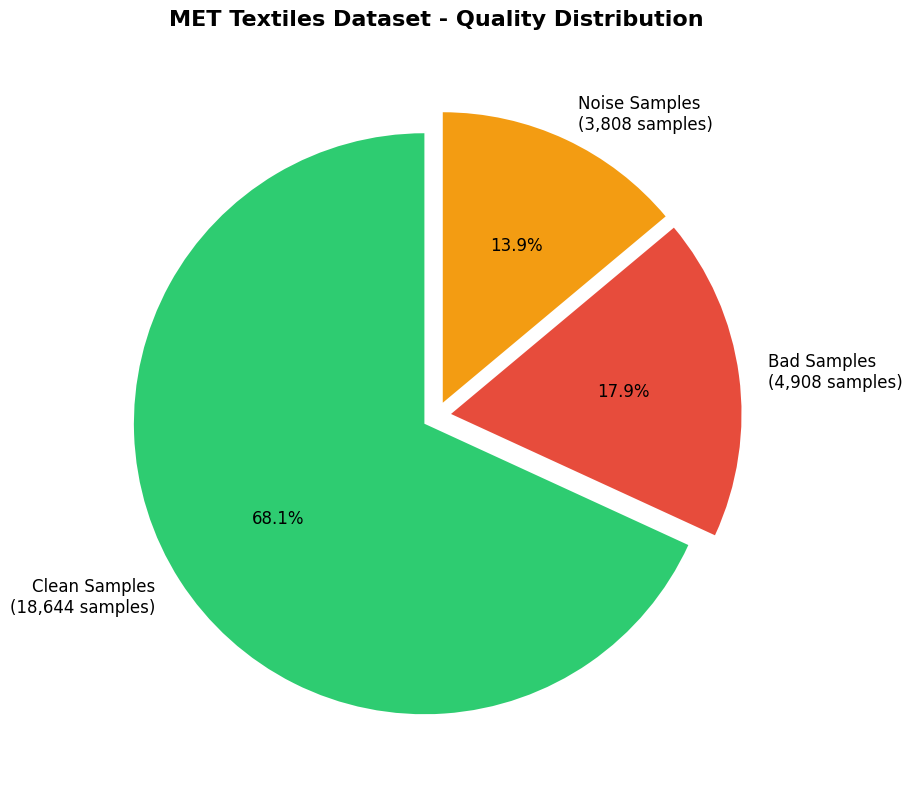

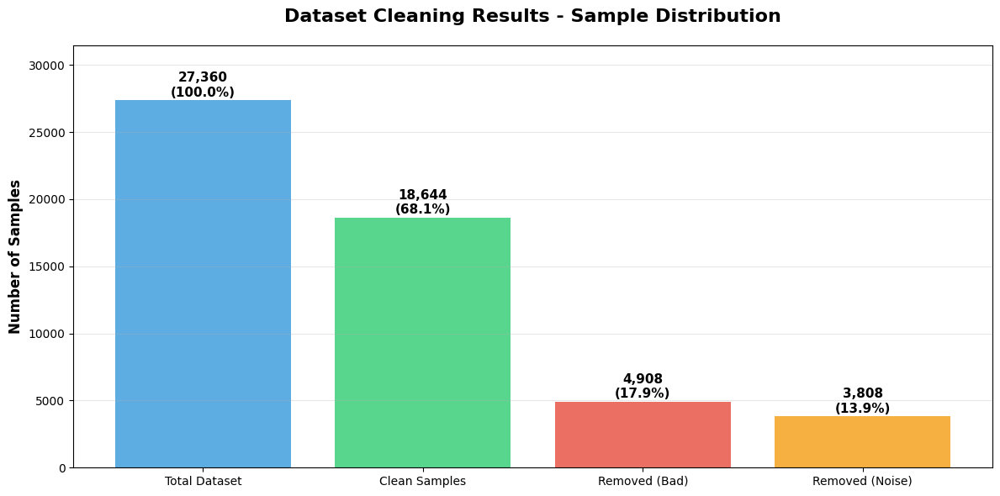

In [27]:
import fiftyone as fo
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
from collections import Counter
import os

# Create output directory for plots
output_dir = "dataset_final_stats"
os.makedirs(output_dir, exist_ok=True)

# Load the dataset
ds = fo.load_dataset("met_textiles_27k")

# Get tag counts
tag_counts = ds.count_sample_tags()
n_bad = tag_counts.get("bad", 0)
n_noise = tag_counts.get("noise", 0)
total_samples = len(ds)
clean_samples = total_samples - n_bad - n_noise

print("🎨 Creating comprehensive dataset visualization...")

# 1. DATASET OVERVIEW PIE CHART
fig, ax = plt.subplots(figsize=(10, 8))
sizes = [clean_samples, n_bad, n_noise]
labels = ['Clean Samples', 'Bad Samples', 'Noise Samples']
colors = ['#2ecc71', '#e74c3c', '#f39c12']
explode = (0.05, 0.05, 0.05)

wedges, texts, autotexts = ax.pie(sizes, labels=labels, colors=colors, autopct='%1.1f%%', 
                                  explode=explode, startangle=90, textprops={'fontsize': 12})

ax.set_title('MET Textiles Dataset - Quality Distribution', fontsize=16, fontweight='bold', pad=20)

# Add sample counts to labels
for i, (label, count) in enumerate(zip(labels, sizes)):
    texts[i].set_text(f'{label}\n({count:,} samples)')

plt.tight_layout()
plt.savefig(f"{output_dir}/01_dataset_quality_overview.png", dpi=300, bbox_inches='tight')
plt.show()

# 2. CLEANING PROGRESS BAR CHART
fig, ax = plt.subplots(figsize=(12, 6))
categories = ['Total Dataset', 'Clean Samples', 'Removed (Bad)', 'Removed (Noise)']
values = [total_samples, clean_samples, n_bad, n_noise]
colors = ['#3498db', '#2ecc71', '#e74c3c', '#f39c12']

bars = ax.bar(categories, values, color=colors, alpha=0.8)

# Add value labels on bars
for bar, value in zip(bars, values):
    height = bar.get_height()
    ax.text(bar.get_x() + bar.get_width()/2., height + 100,
            f'{value:,}\n({value/total_samples*100:.1f}%)',
            ha='center', va='bottom', fontweight='bold', fontsize=11)

ax.set_ylabel('Number of Samples', fontsize=12, fontweight='bold')
ax.set_title('Dataset Cleaning Results - Sample Distribution', fontsize=16, fontweight='bold', pad=20)
ax.grid(axis='y', alpha=0.3)
ax.set_ylim(0, max(values) * 1.15)

plt.tight_layout()
plt.savefig(f"{output_dir}/02_cleaning_results.png", dpi=300, bbox_inches='tight')
plt.show()


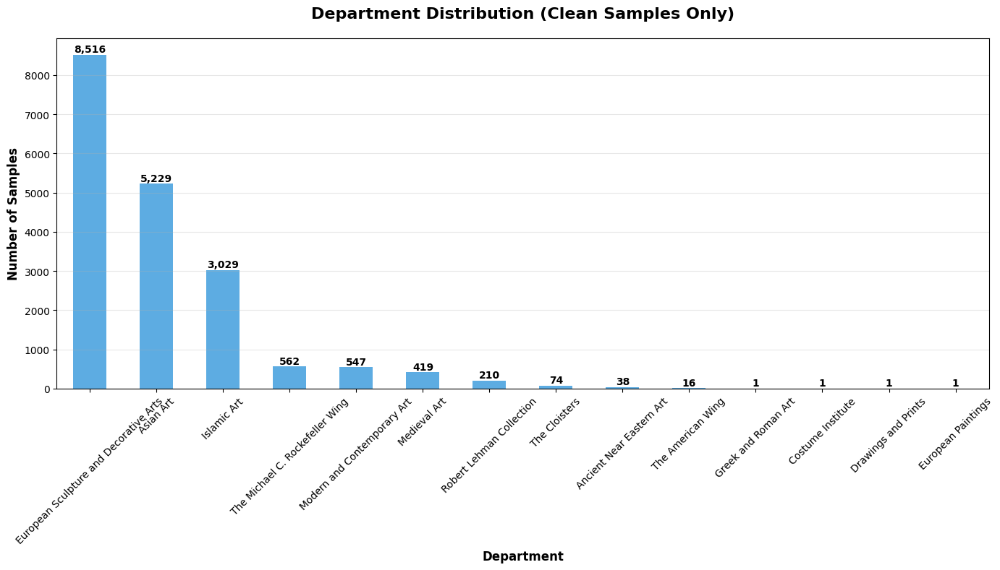

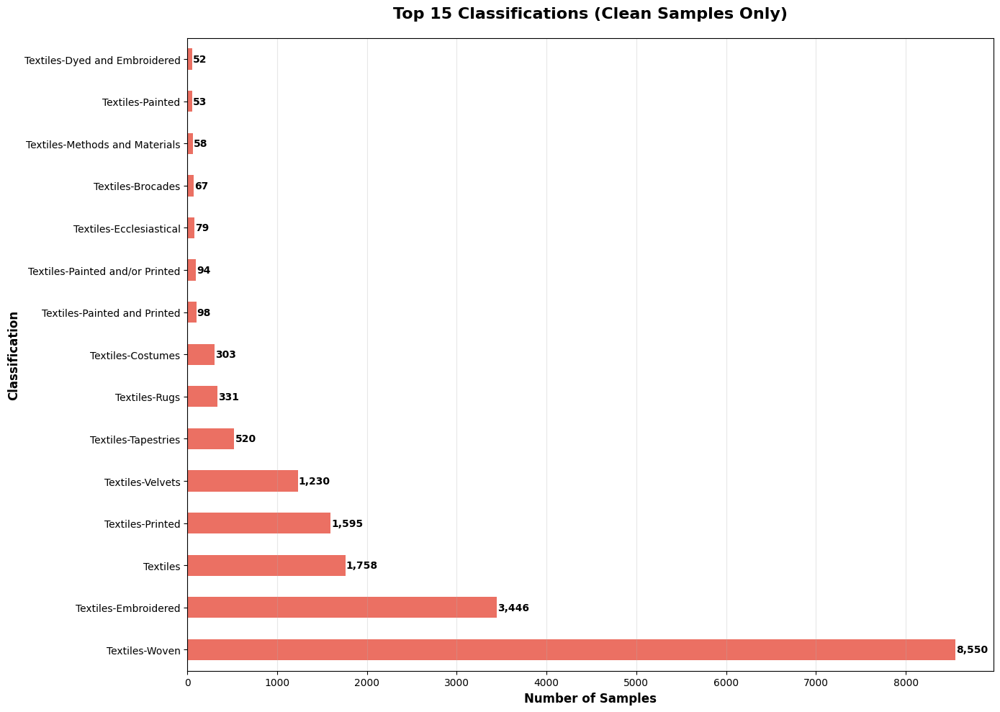

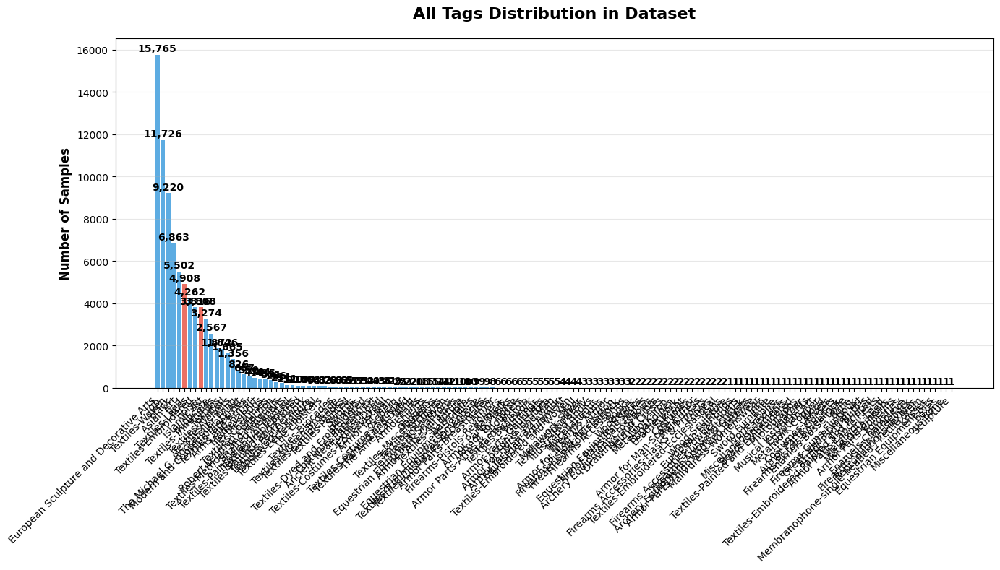

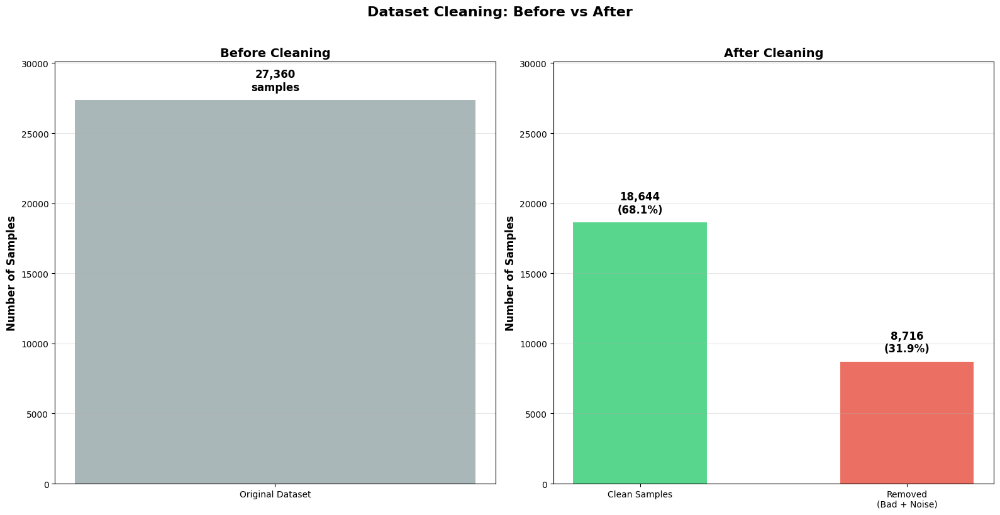

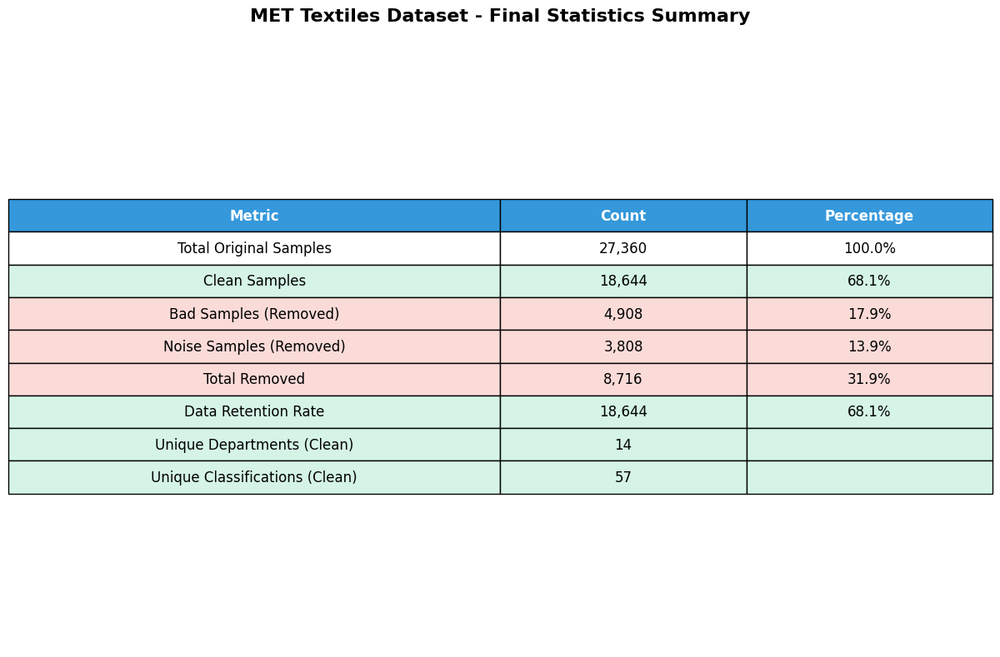

/tmp/ipykernel_30628/2295744244.py:256: UserWarning: Glyph 127919 (\N{DIRECT HIT}) missing from font(s) DejaVu Sans Mono.
  plt.savefig(f"{output_dir}/08_comprehensive_dashboard.png", dpi=300, bbox_inches='tight')
/tmp/ipykernel_30628/2295744244.py:256: UserWarning: Glyph 128202 (\N{BAR CHART}) missing from font(s) DejaVu Sans Mono.
  plt.savefig(f"{output_dir}/08_comprehensive_dashboard.png", dpi=300, bbox_inches='tight')
/tmp/ipykernel_30628/2295744244.py:256: UserWarning: Glyph 129529 (\N{BROOM}) missing from font(s) DejaVu Sans Mono.
  plt.savefig(f"{output_dir}/08_comprehensive_dashboard.png", dpi=300, bbox_inches='tight')
/tmp/ipykernel_30628/2295744244.py:256: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans Mono.
  plt.savefig(f"{output_dir}/08_comprehensive_dashboard.png", dpi=300, bbox_inches='tight')
/tmp/ipykernel_30628/2295744244.py:256: UserWarning: Glyph 10024 (\N{SPARKLES}) missing from font(s) DejaVu Sans Mono.
  plt.savefig(f"{outp

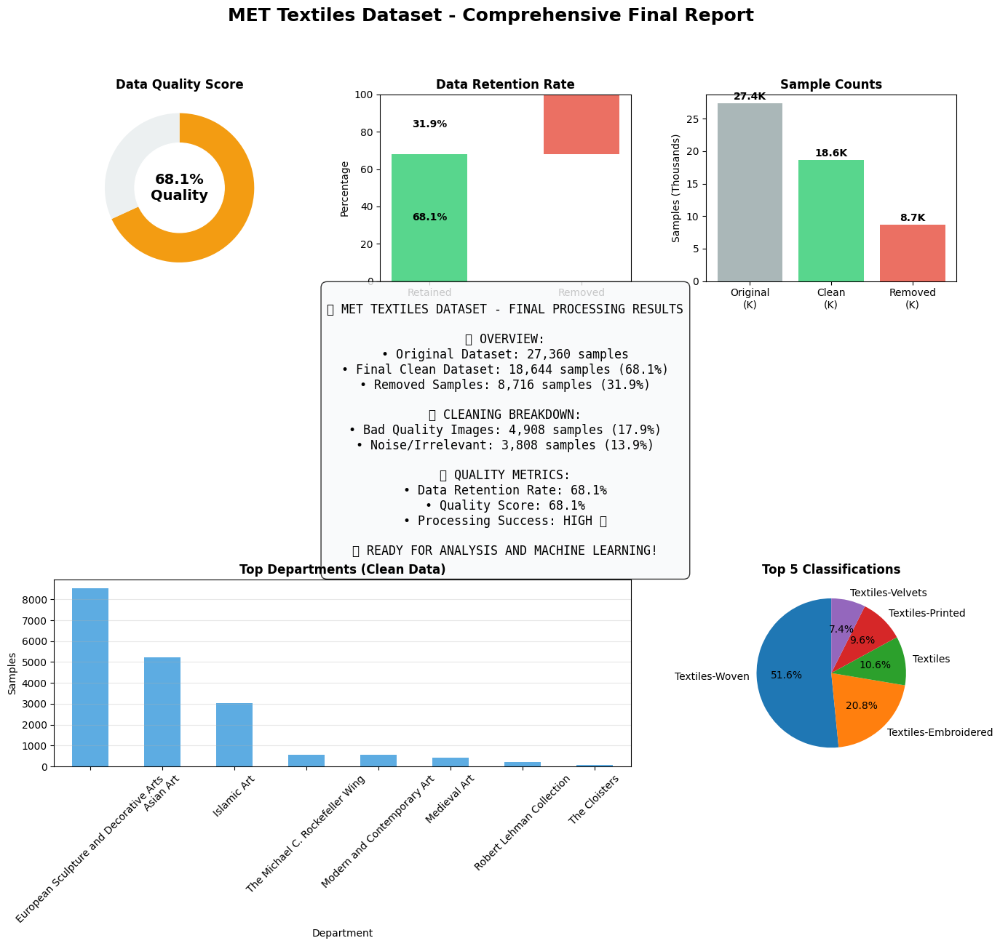


🎉 VISUALIZATION COMPLETE!
📁 All plots saved to: dataset_final_stats/
📊 Generated 8 comprehensive visualizations
✨ Dataset is ready for analysis!

📁 Generated Files:
   • 01_dataset_quality_overview.png
   • 02_cleaning_results.png
   • 03_departments_clean.png
   • 04_classifications_clean.png
   • 05_all_tags_distribution.png
   • 06_before_after_comparison.png
   • 07_summary_statistics.png
   • 08_comprehensive_dashboard.png

📋 FINAL DATASET SUMMARY
🗂️  Original samples: 27,360
✅ Clean samples: 18,644 (68.1%)
❌ Bad samples: 4,908 (17.9%)
🔊 Noise samples: 3,808 (13.9%)
🎯 Data quality score: 68.1%


In [ ]:

# 3. DEPARTMENT DISTRIBUTION (Clean samples only)
clean_view = ds.match(~F("tags").contains("bad")).match(~F("tags").contains("noise"))
if len(clean_view) > 0:
    # Get department counts for clean samples
    dept_data = []
    for sample in clean_view:
        if sample.department:
            dept_data.append(sample.department)
    
    dept_counts = pd.Series(dept_data).value_counts()
    
    fig, ax = plt.subplots(figsize=(14, 8))
    dept_counts.plot(kind='bar', ax=ax, color='#3498db', alpha=0.8)
    ax.set_title('Department Distribution (Clean Samples Only)', fontsize=16, fontweight='bold', pad=20)
    ax.set_xlabel('Department', fontsize=12, fontweight='bold')
    ax.set_ylabel('Number of Samples', fontsize=12, fontweight='bold')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(axis='y', alpha=0.3)
    
    # Add value labels on bars
    for i, v in enumerate(dept_counts.values):
        ax.text(i, v + 10, f'{v:,}', ha='center', va='bottom', fontweight='bold')
    
    plt.tight_layout()
    plt.savefig(f"{output_dir}/03_departments_clean.png", dpi=300, bbox_inches='tight')
    plt.show()

# 4. CLASSIFICATION DISTRIBUTION (Clean samples only)
if len(clean_view) > 0:
    class_data = []
    for sample in clean_view:
        if sample.classification:
            class_data.append(sample.classification)
    
    class_counts = pd.Series(class_data).value_counts().head(15)
    
    fig, ax = plt.subplots(figsize=(14, 10))
    class_counts.plot(kind='barh', ax=ax, color='#e74c3c', alpha=0.8)
    ax.set_title('Top 15 Classifications (Clean Samples Only)', fontsize=16, fontweight='bold', pad=20)
    ax.set_xlabel('Number of Samples', fontsize=12, fontweight='bold')
    ax.set_ylabel('Classification', fontsize=12, fontweight='bold')
    ax.grid(axis='x', alpha=0.3)
    
    # Add value labels
    for i, v in enumerate(class_counts.values):
        ax.text(v + 10, i, f'{v:,}', va='center', fontweight='bold')
    
    plt.tight_layout()
    plt.savefig(f"{output_dir}/04_classifications_clean.png", dpi=300, bbox_inches='tight')
    plt.show()

# 5. ALL TAGS DISTRIBUTION
if tag_counts:
    fig, ax = plt.subplots(figsize=(14, 8))
    tags_df = pd.Series(tag_counts).sort_values(ascending=False)
    
    # Color code: red for bad/noise, blue for others
    colors = []
    for tag in tags_df.index:
        if tag in ['bad', 'noise']:
            colors.append('#e74c3c')
        else:
            colors.append('#3498db')
    
    bars = ax.bar(range(len(tags_df)), tags_df.values, color=colors, alpha=0.8)
    ax.set_xticks(range(len(tags_df)))
    ax.set_xticklabels(tags_df.index, rotation=45, ha='right')
    ax.set_ylabel('Number of Samples', fontsize=12, fontweight='bold')
    ax.set_title('All Tags Distribution in Dataset', fontsize=16, fontweight='bold', pad=20)
    ax.grid(axis='y', alpha=0.3)
    
    # Add value labels
    for bar, value in zip(bars, tags_df.values):
        height = bar.get_height()
        ax.text(bar.get_x() + bar.get_width()/2., height + 50,
                f'{value:,}', ha='center', va='bottom', fontweight='bold')
    
    plt.tight_layout()
    plt.savefig(f"{output_dir}/05_all_tags_distribution.png", dpi=300, bbox_inches='tight')
    plt.show()

# 6. BEFORE vs AFTER COMPARISON
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# Before cleaning
before_data = [total_samples]
before_labels = ['Original Dataset']
ax1.bar(before_labels, before_data, color='#95a5a6', alpha=0.8, width=0.5)
ax1.set_title('Before Cleaning', fontsize=14, fontweight='bold')
ax1.set_ylabel('Number of Samples', fontsize=12, fontweight='bold')
ax1.text(0, total_samples + 500, f'{total_samples:,}\nsamples', ha='center', va='bottom', 
         fontweight='bold', fontsize=12)
ax1.set_ylim(0, total_samples * 1.1)
ax1.grid(axis='y', alpha=0.3)

# After cleaning
after_data = [clean_samples, n_bad + n_noise]
after_labels = ['Clean Samples', 'Removed\n(Bad + Noise)']
colors_after = ['#2ecc71', '#e74c3c']
bars2 = ax2.bar(after_labels, after_data, color=colors_after, alpha=0.8, width=0.5)
ax2.set_title('After Cleaning', fontsize=14, fontweight='bold')
ax2.set_ylabel('Number of Samples', fontsize=12, fontweight='bold')
ax2.set_ylim(0, total_samples * 1.1)
ax2.grid(axis='y', alpha=0.3)

# Add labels
for bar, value in zip(bars2, after_data):
    height = bar.get_height()
    ax2.text(bar.get_x() + bar.get_width()/2., height + 500,
             f'{value:,}\n({value/total_samples*100:.1f}%)',
             ha='center', va='bottom', fontweight='bold', fontsize=12)

plt.suptitle('Dataset Cleaning: Before vs After', fontsize=16, fontweight='bold', y=1.02)
plt.tight_layout()
plt.savefig(f"{output_dir}/06_before_after_comparison.png", dpi=300, bbox_inches='tight')
plt.show()

# 7. SUMMARY STATISTICS TABLE
fig, ax = plt.subplots(figsize=(12, 8))
ax.axis('tight')
ax.axis('off')

# Create summary data
summary_data = [
    ['Total Original Samples', f'{total_samples:,}', '100.0%'],
    ['Clean Samples', f'{clean_samples:,}', f'{clean_samples/total_samples*100:.1f}%'],
    ['Bad Samples (Removed)', f'{n_bad:,}', f'{n_bad/total_samples*100:.1f}%'],
    ['Noise Samples (Removed)', f'{n_noise:,}', f'{n_noise/total_samples*100:.1f}%'],
    ['Total Removed', f'{n_bad + n_noise:,}', f'{(n_bad + n_noise)/total_samples*100:.1f}%'],
    ['Data Retention Rate', f'{clean_samples:,}', f'{clean_samples/total_samples*100:.1f}%'],
]

# Add department and classification counts if available
if len(clean_view) > 0:
    unique_depts = len(set(s.department for s in clean_view if s.department))
    unique_classes = len(set(s.classification for s in clean_view if s.classification))
    summary_data.extend([
        ['Unique Departments (Clean)', f'{unique_depts}', ''],
        ['Unique Classifications (Clean)', f'{unique_classes}', ''],
    ])

table = ax.table(cellText=summary_data,
                colLabels=['Metric', 'Count', 'Percentage'],
                cellLoc='center',
                loc='center',
                colWidths=[0.5, 0.25, 0.25])

table.auto_set_font_size(False)
table.set_fontsize(12)
table.scale(1.2, 2)

# Style the table
for i in range(len(summary_data) + 1):
    for j in range(3):
        cell = table[(i, j)]
        if i == 0:  # Header
            cell.set_facecolor('#3498db')
            cell.set_text_props(weight='bold', color='white')
        elif 'Clean' in summary_data[i-1][0] or 'Retention' in summary_data[i-1][0]:
            cell.set_facecolor('#d5f4e6')  # Light green for good metrics
        elif 'Removed' in summary_data[i-1][0] or 'Bad' in summary_data[i-1][0] or 'Noise' in summary_data[i-1][0]:
            cell.set_facecolor('#fadbd8')  # Light red for removed items

ax.set_title('MET Textiles Dataset - Final Statistics Summary', 
             fontsize=16, fontweight='bold', pad=20)

plt.tight_layout()
plt.savefig(f"{output_dir}/07_summary_statistics.png", dpi=300, bbox_inches='tight')
plt.show()

# 8. FINAL QUALITY METRICS DASHBOARD
fig = plt.figure(figsize=(16, 12))
gs = fig.add_gridspec(3, 3, hspace=0.3, wspace=0.3)

# Quality score gauge
ax1 = fig.add_subplot(gs[0, 0])
quality_score = clean_samples / total_samples * 100
colors_gauge = ['#e74c3c' if quality_score < 50 else '#f39c12' if quality_score < 70 else '#2ecc71']
ax1.pie([quality_score, 100-quality_score], colors=[colors_gauge[0], '#ecf0f1'], 
        startangle=90, counterclock=False)
ax1.add_artist(plt.Circle((0,0), 0.6, color='white'))
ax1.text(0, 0, f'{quality_score:.1f}%\nQuality', ha='center', va='center', 
         fontsize=14, fontweight='bold')
ax1.set_title('Data Quality Score', fontweight='bold')

# Retention rate
ax2 = fig.add_subplot(gs[0, 1])
retention_rate = clean_samples / total_samples * 100
ax2.bar(['Retained'], [retention_rate], color='#2ecc71', alpha=0.8, width=0.5)
ax2.bar(['Removed'], [100-retention_rate], bottom=[retention_rate], color='#e74c3c', alpha=0.8, width=0.5)
ax2.set_ylim(0, 100)
ax2.set_ylabel('Percentage')
ax2.set_title('Data Retention Rate', fontweight='bold')
ax2.text(0, retention_rate/2, f'{retention_rate:.1f}%', ha='center', va='center', fontweight='bold')
ax2.text(0, retention_rate + (100-retention_rate)/2, f'{100-retention_rate:.1f}%', ha='center', va='center', fontweight='bold')

# Sample counts
ax3 = fig.add_subplot(gs[0, 2])
sample_data = [total_samples/1000, clean_samples/1000, (n_bad + n_noise)/1000]
sample_labels = ['Original\n(K)', 'Clean\n(K)', 'Removed\n(K)']
colors_samples = ['#95a5a6', '#2ecc71', '#e74c3c']
bars = ax3.bar(sample_labels, sample_data, color=colors_samples, alpha=0.8)
ax3.set_ylabel('Samples (Thousands)')
ax3.set_title('Sample Counts', fontweight='bold')
for bar, value in zip(bars, sample_data):
    height = bar.get_height()
    ax3.text(bar.get_x() + bar.get_width()/2., height + 0.2,
             f'{value:.1f}K', ha='center', va='bottom', fontweight='bold')

# Department distribution (clean)
if len(clean_view) > 0 and dept_data:
    ax5 = fig.add_subplot(gs[2, :2])
    top_depts = dept_counts.head(8)
    top_depts.plot(kind='bar', ax=ax5, color='#3498db', alpha=0.8)
    ax5.set_title('Top Departments (Clean Data)', fontweight='bold')
    ax5.set_xlabel('Department')
    ax5.set_ylabel('Samples')
    ax5.tick_params(axis='x', rotation=45)
    ax5.grid(axis='y', alpha=0.3)

# Classification distribution (clean)
if len(clean_view) > 0 and class_data:
    ax6 = fig.add_subplot(gs[2, 2])
    top_classes = class_counts.head(5)
    top_classes.plot(kind='pie', ax=ax6, autopct='%1.1f%%', startangle=90)
    ax6.set_title('Top 5 Classifications', fontweight='bold')
    ax6.set_ylabel('')

plt.suptitle('MET Textiles Dataset - Comprehensive Final Report', fontsize=18, fontweight='bold', y=0.98)
plt.savefig(f"{output_dir}/08_comprehensive_dashboard.png", dpi=300, bbox_inches='tight')
plt.show()

print(f"\n🎉 VISUALIZATION COMPLETE!")
print(f"📁 All plots saved to: {output_dir}/")
print(f"📊 Generated 8 comprehensive visualizations")
print(f"✨ Dataset is ready for analysis!")

# List all generated files
import glob
generated_files = glob.glob(f"{output_dir}/*.png")
print(f"\n📁 Generated Files:")
for file in sorted(generated_files):
    print(f"   • {os.path.basename(file)}")

# Final summary with key metrics
print(f"\n" + "="*60)
print("📋 FINAL DATASET SUMMARY")
print("="*60)
print(f"🗂️  Original samples: {total_samples:,}")
print(f"✅ Clean samples: {clean_samples:,} ({clean_samples/total_samples*100:.1f}%)")
print(f"❌ Bad samples: {n_bad:,} ({n_bad/total_samples*100:.1f}%)")
print(f"🔊 Noise samples: {n_noise:,} ({n_noise/total_samples*100:.1f}%)")
print(f"🎯 Data quality score: {clean_samples/total_samples*100:.1f}%")
print("="*60)

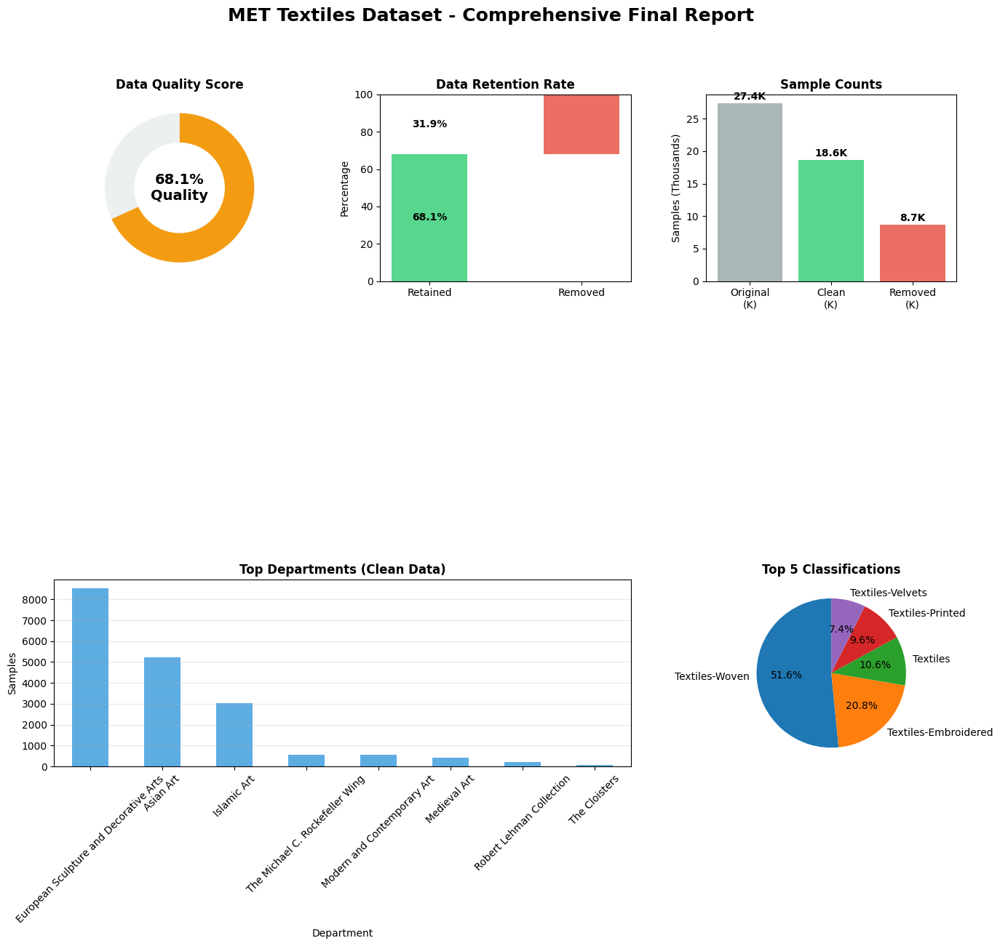

In [30]:
# 8. FINAL QUALITY METRICS DASHBOARD
fig = plt.figure(figsize=(16, 12))
gs = fig.add_gridspec(3, 3, hspace=0.3, wspace=0.3)

# Quality score gauge
ax1 = fig.add_subplot(gs[0, 0])
quality_score = clean_samples / total_samples * 100
colors_gauge = ['#e74c3c' if quality_score < 50 else '#f39c12' if quality_score < 70 else '#2ecc71']
ax1.pie([quality_score, 100-quality_score], colors=[colors_gauge[0], '#ecf0f1'], 
        startangle=90, counterclock=False)
ax1.add_artist(plt.Circle((0,0), 0.6, color='white'))
ax1.text(0, 0, f'{quality_score:.1f}%\nQuality', ha='center', va='center', 
         fontsize=14, fontweight='bold')
ax1.set_title('Data Quality Score', fontweight='bold')

# Retention rate
ax2 = fig.add_subplot(gs[0, 1])
retention_rate = clean_samples / total_samples * 100
ax2.bar(['Retained'], [retention_rate], color='#2ecc71', alpha=0.8, width=0.5)
ax2.bar(['Removed'], [100-retention_rate], bottom=[retention_rate], color='#e74c3c', alpha=0.8, width=0.5)
ax2.set_ylim(0, 100)
ax2.set_ylabel('Percentage')
ax2.set_title('Data Retention Rate', fontweight='bold')
ax2.text(0, retention_rate/2, f'{retention_rate:.1f}%', ha='center', va='center', fontweight='bold')
ax2.text(0, retention_rate + (100-retention_rate)/2, f'{100-retention_rate:.1f}%', ha='center', va='center', fontweight='bold')

# Sample counts
ax3 = fig.add_subplot(gs[0, 2])
sample_data = [total_samples/1000, clean_samples/1000, (n_bad + n_noise)/1000]
sample_labels = ['Original\n(K)', 'Clean\n(K)', 'Removed\n(K)']
colors_samples = ['#95a5a6', '#2ecc71', '#e74c3c']
bars = ax3.bar(sample_labels, sample_data, color=colors_samples, alpha=0.8)
ax3.set_ylabel('Samples (Thousands)')
ax3.set_title('Sample Counts', fontweight='bold')
for bar, value in zip(bars, sample_data):
    height = bar.get_height()
    ax3.text(bar.get_x() + bar.get_width()/2., height + 0.2,
             f'{value:.1f}K', ha='center', va='bottom', fontweight='bold')

# Department distribution (clean)
if len(clean_view) > 0 and dept_data:
    ax5 = fig.add_subplot(gs[2, :2])
    top_depts = dept_counts.head(8)
    top_depts.plot(kind='bar', ax=ax5, color='#3498db', alpha=0.8)
    ax5.set_title('Top Departments (Clean Data)', fontweight='bold')
    ax5.set_xlabel('Department')
    ax5.set_ylabel('Samples')
    ax5.tick_params(axis='x', rotation=45)
    ax5.grid(axis='y', alpha=0.3)

# Classification distribution (clean)
if len(clean_view) > 0 and class_data:
    ax6 = fig.add_subplot(gs[2, 2])
    top_classes = class_counts.head(5)
    top_classes.plot(kind='pie', ax=ax6, autopct='%1.1f%%', startangle=90)
    ax6.set_title('Top 5 Classifications', fontweight='bold')
    ax6.set_ylabel('')

plt.suptitle('MET Textiles Dataset - Comprehensive Final Report', fontsize=18, fontweight='bold', y=0.98)
plt.savefig(f"{output_dir}/08_comprehensive_dashboard.png", dpi=300, bbox_inches='tight')

🔍 Analyzing department data quality...
📊 Department Analysis:
   • Total clean samples: 18,644
   • Samples with missing department: 0 (0.0%)
   • Samples with valid department: 18,644 (100.0%)
   • Unique departments (original): 17
   • Unique departments (clean): 14


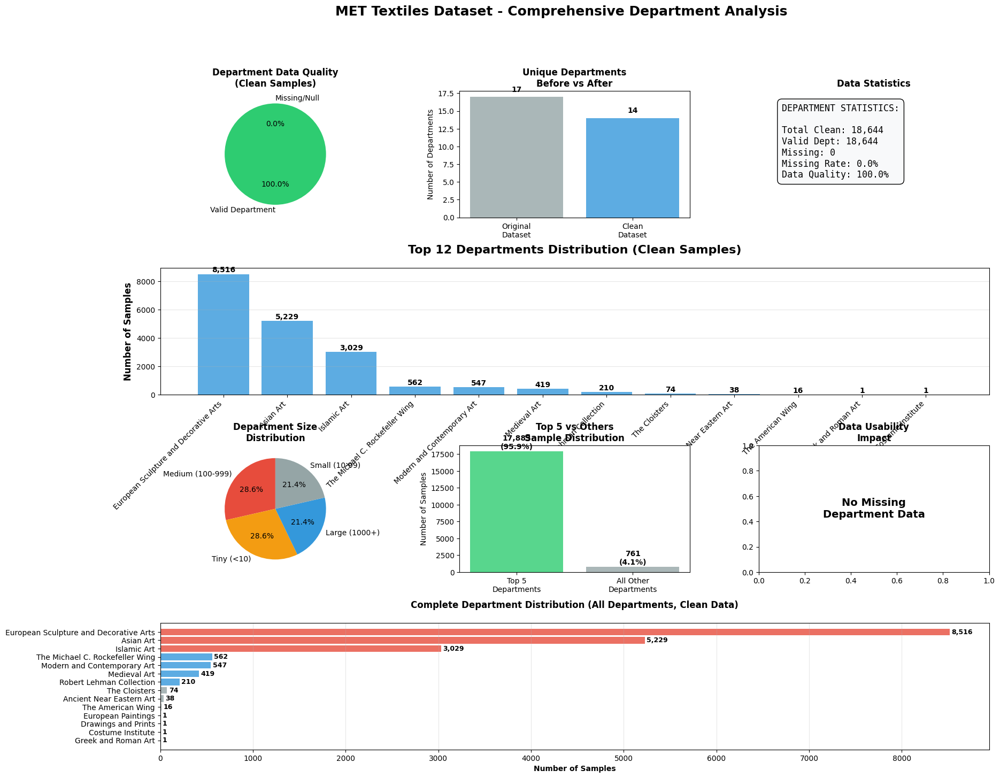


📋 DETAILED DEPARTMENT ANALYSIS SUMMARY
🗂️  Total clean samples: 18,644
❓ Missing department data: 0 (0.0%)
✅ Valid department data: 18,644 (100.0%)
🏢 Unique departments (original): 17
🏢 Unique departments (clean): 14
📉 Departments lost in cleaning: 3

📊 TOP 10 DEPARTMENTS (Clean Data):
 1. 📁 European Sculpture and Decorative Arts |  8,516 samples ( 45.7%)
 2. 📁 Asian Art                           |  5,229 samples ( 28.0%)
 3. 📁 Islamic Art                         |  3,029 samples ( 16.2%)
 4. 📁 The Michael C. Rockefeller Wing     |    562 samples (  3.0%)
 5. 📁 Modern and Contemporary Art         |    547 samples (  2.9%)
 6. 📁 Medieval Art                        |    419 samples (  2.2%)
 7. 📁 Robert Lehman Collection            |    210 samples (  1.1%)
 8. 📁 The Cloisters                       |     74 samples (  0.4%)
 9. 📁 Ancient Near Eastern Art            |     38 samples (  0.2%)
10. 📁 The American Wing                   |     16 samples (  0.1%)

🎯 DEPARTMENT SIZE ANALYSIS:


In [33]:
# Enhanced department analysis with null handling and before/after comparison
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Handle null/missing departments in the FiftyOne dataset
print("🔍 Analyzing department data quality...")

# Get all department values from clean samples
dept_data_raw = []
dept_data_with_nulls = []

for sample in clean_view:
    dept_raw = sample.department
    dept_data_with_nulls.append(dept_raw)
    
    # Replace null/empty with "Others"
    if dept_raw and dept_raw.strip():
        dept_data_raw.append(dept_raw)
    else:
        dept_data_raw.append("Others")

dept_data = dept_data_raw  # Use cleaned data

# Count nulls/missing
null_count = sum(1 for d in dept_data_with_nulls if not d or not d.strip())
total_clean = len(dept_data_with_nulls)

print(f"📊 Department Analysis:")
print(f"   • Total clean samples: {total_clean:,}")
print(f"   • Samples with missing department: {null_count:,} ({null_count/total_clean*100:.1f}%)")
print(f"   • Samples with valid department: {total_clean - null_count:,} ({(total_clean - null_count)/total_clean*100:.1f}%)")

# Get department counts
dept_counts = pd.Series(dept_data).value_counts()
unique_depts_clean = len(dept_counts) - (1 if "Others" in dept_counts.index else 0)

# Also get department counts from original dataset for comparison
original_dept_data = []
for sample in ds:
    dept = sample.department
    if dept and dept.strip():
        original_dept_data.append(dept)
    else:
        original_dept_data.append("Others")

original_dept_counts = pd.Series(original_dept_data).value_counts()
unique_depts_original = len(original_dept_counts) - (1 if "Others" in original_dept_counts.index else 0)

print(f"   • Unique departments (original): {unique_depts_original}")
print(f"   • Unique departments (clean): {unique_depts_clean}")

# Create comprehensive department visualization
fig = plt.figure(figsize=(20, 16))
gs = fig.add_gridspec(4, 3, hspace=0.4, wspace=0.3)

# 1. Data Quality Overview
ax1 = fig.add_subplot(gs[0, 0])
quality_data = [total_clean - null_count, null_count]
quality_labels = ['Valid Department', 'Missing/Null']
colors = ['#2ecc71', '#e74c3c']
wedges, texts, autotexts = ax1.pie(quality_data, labels=quality_labels, colors=colors, 
                                   autopct='%1.1f%%', startangle=90)
ax1.set_title('Department Data Quality\n(Clean Samples)', fontweight='bold')

# 2. Before vs After Department Count
ax2 = fig.add_subplot(gs[0, 1])
dept_comparison = [unique_depts_original, unique_depts_clean]
dept_labels = ['Original\nDataset', 'Clean\nDataset']
bars = ax2.bar(dept_labels, dept_comparison, color=['#95a5a6', '#3498db'], alpha=0.8)
ax2.set_title('Unique Departments\nBefore vs After', fontweight='bold')
ax2.set_ylabel('Number of Departments')
for bar, value in zip(bars, dept_comparison):
    height = bar.get_height()
    ax2.text(bar.get_x() + bar.get_width()/2., height + 0.5,
             f'{value}', ha='center', va='bottom', fontweight='bold')

# 3. Missing Department Analysis
ax3 = fig.add_subplot(gs[0, 2])
missing_stats = [
    f"Total Clean: {total_clean:,}",
    f"Valid Dept: {total_clean - null_count:,}",
    f"Missing: {null_count:,}",
    f"Missing Rate: {null_count/total_clean*100:.1f}%",
    f"Data Quality: {(total_clean - null_count)/total_clean*100:.1f}%"
]
ax3.text(0.1, 0.9, "DEPARTMENT STATISTICS:\n\n" + "\n".join(missing_stats), 
         transform=ax3.transAxes, fontsize=12, verticalalignment='top', 
         fontfamily='monospace', bbox=dict(boxstyle="round,pad=0.5", facecolor='#f8f9fa'))
ax3.set_title('Data Statistics', fontweight='bold')
ax3.axis('off')

# 4. Top Departments Distribution (Clean Data)
ax4 = fig.add_subplot(gs[1, :])
top_depts = dept_counts.head(12)
bars = ax4.bar(range(len(top_depts)), top_depts.values, color='#3498db', alpha=0.8)
ax4.set_title('Top 12 Departments Distribution (Clean Samples)', fontsize=16, fontweight='bold', pad=20)
ax4.set_xlabel('Department', fontsize=12, fontweight='bold')
ax4.set_ylabel('Number of Samples', fontsize=12, fontweight='bold')
ax4.set_xticks(range(len(top_depts)))
ax4.set_xticklabels(top_depts.index, rotation=45, ha='right')
ax4.grid(axis='y', alpha=0.3)

# Add value labels on bars
for i, (bar, value) in enumerate(zip(bars, top_depts.values)):
    height = bar.get_height()
    # Color "Others" bar differently
    if top_depts.index[i] == "Others":
        bar.set_color('#f39c12')
    ax4.text(bar.get_x() + bar.get_width()/2., height + 20,
             f'{value:,}', ha='center', va='bottom', fontweight='bold', fontsize=10)

# 5. Department Size Categories
ax5 = fig.add_subplot(gs[2, 0])
dept_sizes = []
for count in dept_counts.values:
    if count >= 1000:
        dept_sizes.append("Large (1000+)")
    elif count >= 100:
        dept_sizes.append("Medium (100-999)")
    elif count >= 10:
        dept_sizes.append("Small (10-99)")
    else:
        dept_sizes.append("Tiny (<10)")

size_counts = pd.Series(dept_sizes).value_counts()
size_counts.plot(kind='pie', ax=ax5, autopct='%1.1f%%', startangle=90, 
                colors=['#e74c3c', '#f39c12', '#3498db', '#95a5a6'])
ax5.set_title('Department Size\nDistribution', fontweight='bold')
ax5.set_ylabel('')

# 6. Top vs Others Comparison
ax6 = fig.add_subplot(gs[2, 1])
top_5_sum = dept_counts.head(5).sum()
others_sum = dept_counts.sum() - top_5_sum
comparison_data = [top_5_sum, others_sum]
comparison_labels = ['Top 5\nDepartments', 'All Other\nDepartments']
bars = ax6.bar(comparison_labels, comparison_data, color=['#2ecc71', '#95a5a6'], alpha=0.8)
ax6.set_title('Top 5 vs Others\nSample Distribution', fontweight='bold')
ax6.set_ylabel('Number of Samples')
for bar, value in zip(bars, comparison_data):
    height = bar.get_height()
    ax6.text(bar.get_x() + bar.get_width()/2., height + 100,
             f'{value:,}\n({value/dept_counts.sum()*100:.1f}%)',
             ha='center', va='bottom', fontweight='bold')

# 7. Missing Department Impact
ax7 = fig.add_subplot(gs[2, 2])
if null_count > 0:
    impact_data = [total_clean - null_count, null_count]
    impact_labels = ['Usable for\nDept Analysis', 'Lost to\nMissing Data']
    bars = ax7.bar(impact_labels, impact_data, color=['#2ecc71', '#e74c3c'], alpha=0.8)
    ax7.set_title('Data Usability\nImpact', fontweight='bold')
    ax7.set_ylabel('Number of Samples')
    for bar, value in zip(bars, impact_data):
        height = bar.get_height()
        ax7.text(bar.get_x() + bar.get_width()/2., height + 100,
                 f'{value:,}', ha='center', va='bottom', fontweight='bold')
else:
    ax7.text(0.5, 0.5, 'No Missing\nDepartment Data', ha='center', va='center', 
             fontsize=14, fontweight='bold', transform=ax7.transAxes)
    ax7.set_title('Data Usability\nImpact', fontweight='bold')

# 8. Department Coverage Analysis
ax8 = fig.add_subplot(gs[3, :])
# Create a horizontal bar chart showing all departments
all_dept_counts = dept_counts.sort_values(ascending=True)
y_pos = np.arange(len(all_dept_counts))

# Color bars based on department type
colors = []
for dept in all_dept_counts.index:
    if dept == "Others":
        colors.append('#f39c12')  # Orange for Others
    elif all_dept_counts[dept] >= 1000:
        colors.append('#e74c3c')  # Red for large
    elif all_dept_counts[dept] >= 100:
        colors.append('#3498db')  # Blue for medium
    else:
        colors.append('#95a5a6')  # Gray for small

bars = ax8.barh(y_pos, all_dept_counts.values, color=colors, alpha=0.8)
ax8.set_yticks(y_pos)
ax8.set_yticklabels(all_dept_counts.index, fontsize=10)
ax8.set_xlabel('Number of Samples', fontweight='bold')
ax8.set_title('Complete Department Distribution (All Departments, Clean Data)', fontweight='bold', pad=20)
ax8.grid(axis='x', alpha=0.3)

# Add value labels on bars
for i, (bar, value) in enumerate(zip(bars, all_dept_counts.values)):
    width = bar.get_width()
    ax8.text(width + 20, bar.get_y() + bar.get_height()/2.,
             f'{value:,}', ha='left', va='center', fontweight='bold', fontsize=9)

plt.suptitle('MET Textiles Dataset - Comprehensive Department Analysis', 
             fontsize=18, fontweight='bold', y=0.98)
plt.savefig(f"{output_dir}/09_department_comprehensive_analysis.png", dpi=300, bbox_inches='tight')
plt.show()

# Print detailed department summary
print(f"\n" + "="*80)
print("📋 DETAILED DEPARTMENT ANALYSIS SUMMARY")
print("="*80)
print(f"🗂️  Total clean samples: {total_clean:,}")
print(f"❓ Missing department data: {null_count:,} ({null_count/total_clean*100:.1f}%)")
print(f"✅ Valid department data: {total_clean - null_count:,} ({(total_clean - null_count)/total_clean*100:.1f}%)")
print(f"🏢 Unique departments (original): {unique_depts_original}")
print(f"🏢 Unique departments (clean): {unique_depts_clean}")
print(f"📉 Departments lost in cleaning: {unique_depts_original - unique_depts_clean}")

print(f"\n📊 TOP 10 DEPARTMENTS (Clean Data):")
for i, (dept, count) in enumerate(dept_counts.head(10).items(), 1):
    percentage = count / total_clean * 100
    marker = "📁" if dept != "Others" else "❓"
    print(f"{i:2d}. {marker} {dept:<35} | {count:>6,} samples ({percentage:>5.1f}%)")

print(f"\n🎯 DEPARTMENT SIZE ANALYSIS:")
size_analysis = {}
for dept, count in dept_counts.items():
    if count >= 1000:
        size_analysis.setdefault("Large (1000+)", []).append((dept, count))
    elif count >= 100:
        size_analysis.setdefault("Medium (100-999)", []).append((dept, count))
    elif count >= 10:
        size_analysis.setdefault("Small (10-99)", []).append((dept, count))
    else:
        size_analysis.setdefault("Tiny (<10)", []).append((dept, count))

for size_cat, depts in size_analysis.items():
    total_samples = sum(count for _, count in depts)
    print(f"   {size_cat:<15} | {len(depts):>2} departments | {total_samples:>7,} samples")

🔄 Loading original JSON data for analysis...
📊 Clean dataset extracted: 18,644 samples


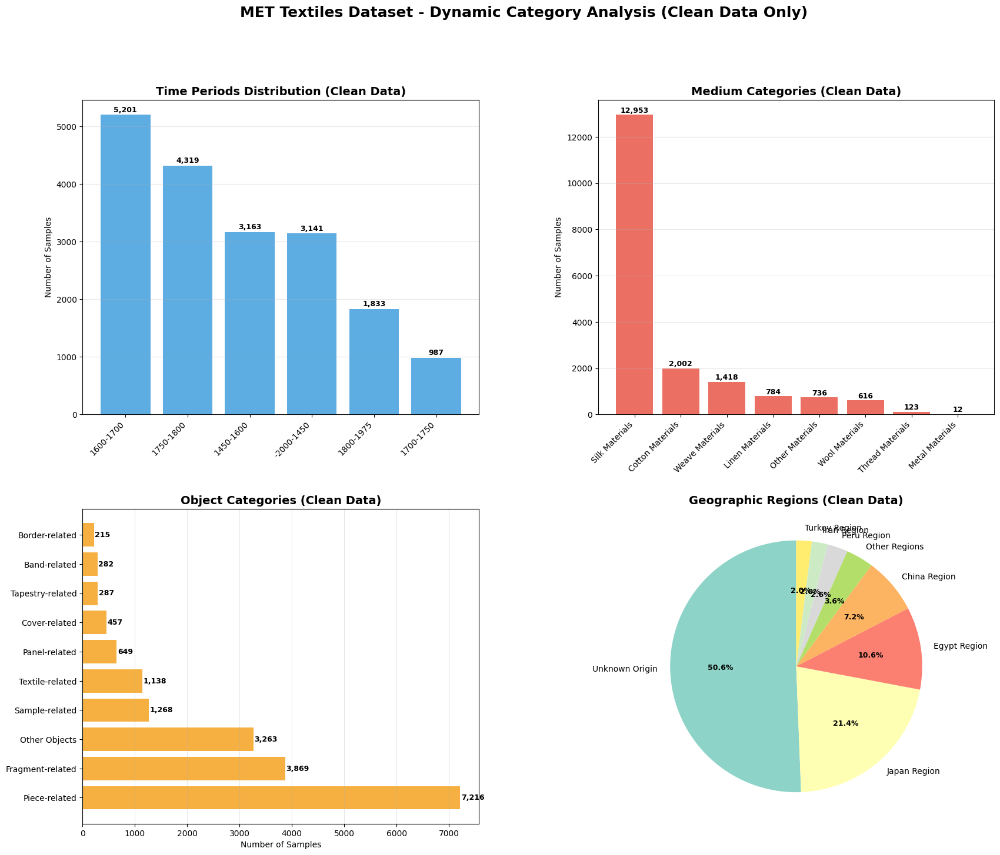


📋 CLEAN DATASET DYNAMIC ANALYSIS SUMMARY
🗂️  Total clean samples analyzed: 18,644
📅 Date range: -2000 - 1975 (3975 years)
📅 Valid dates: 18,644 (100.0%)
📅 Most common period: 1600-1700 (5,201 samples)
🧵 Medium keywords found: 15
🧵 Most common medium: Silk Materials (12,953 samples)
👕 Object keywords found: 10
👕 Most common object: Piece-related (7,216 samples)
🌍 Geographic terms found: 12
🌍 Most common region: Unknown Origin (9,104 samples)

✨ Dynamic categorization complete for clean dataset!
📁 Visualization saved as: 10_dynamic_categories_clean.png


In [ ]:
# Dynamic categorization analysis for CLEAN dataset with 4 key visualizations
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from collections import Counter
import seaborn as sns
import json

# Load the original JSON data for clean samples
print("🔄 Loading original JSON data for analysis...")

json_path = "/home/user1/Desktop/HAMZA/THESIS/TEXMET/FINAL_CORRECTED_MET_TEXTILES_DATASET/objects_with_images_only/ALL_TEXTILES_AND_TAPESTRIES_WITH_IMAGES_20250705_230315.json"

with open(json_path, "r", encoding="utf-8") as f:
    all_data = json.load(f)

# Convert to DataFrame
df_original = pd.DataFrame(all_data)

# Get object IDs from clean FiftyOne dataset
clean_object_ids = set()
for sample in clean_view:
    clean_object_ids.add(sample.object_id)

# Filter original data to only clean samples
clean_df = df_original[df_original['objectID'].isin(clean_object_ids)].copy()

print(f"📊 Clean dataset extracted: {len(clean_df):,} samples")

# Create comprehensive 4-panel analysis
fig = plt.figure(figsize=(20, 16))
gs = fig.add_gridspec(2, 2, hspace=0.3, wspace=0.3)

# 1. TIME PERIODS ANALYSIS (Clean data)
ax1 = fig.add_subplot(gs[0, 0])
clean_df['objectBeginDate'] = pd.to_numeric(clean_df['objectBeginDate'], errors='coerce')
valid_dates = clean_df['objectBeginDate'].dropna()

if len(valid_dates) > 0:
    min_date = int(valid_dates.min())
    max_date = int(valid_dates.max())
    
    # Create 6 dynamic periods based on quantiles
    quantiles = np.linspace(0, 1, 7)
    period_boundaries = valid_dates.quantile(quantiles).astype(int).tolist()
    
    def categorize_period_clean(date):
        if pd.isna(date):
            return "Unknown Date"
        for i in range(len(period_boundaries) - 1):
            if period_boundaries[i] <= date <= period_boundaries[i + 1]:
                return f"{period_boundaries[i]}-{period_boundaries[i + 1]}"
        return "Outside Range"
    
    clean_df['time_period'] = clean_df['objectBeginDate'].apply(categorize_period_clean)
    period_counts = clean_df['time_period'].value_counts().head(8)
    
    bars = ax1.bar(range(len(period_counts)), period_counts.values, color='#3498db', alpha=0.8)
    ax1.set_title('Time Periods Distribution (Clean Data)', fontsize=14, fontweight='bold')
    ax1.set_ylabel('Number of Samples')
    ax1.set_xticks(range(len(period_counts)))
    ax1.set_xticklabels(period_counts.index, rotation=45, ha='right')
    ax1.grid(axis='y', alpha=0.3)
    
    # Add value labels
    for bar, value in zip(bars, period_counts.values):
        height = bar.get_height()
        ax1.text(bar.get_x() + bar.get_width()/2., height + 20,
                 f'{value:,}', ha='center', va='bottom', fontweight='bold', fontsize=9)
else:
    ax1.text(0.5, 0.5, 'No valid date data', ha='center', va='center', transform=ax1.transAxes)
    ax1.set_title('Time Periods Distribution (Clean Data)', fontsize=14, fontweight='bold')

# 2. MEDIUM CATEGORIES ANALYSIS (Clean data)
ax2 = fig.add_subplot(gs[0, 1])
all_mediums = clean_df['medium'].dropna().str.lower()
all_words = []
for medium in all_mediums:
    words = str(medium).replace(',', ' ').replace(';', ' ').split()
    all_words.extend([w.strip() for w in words if len(w) > 3])

if all_words:
    word_freq = Counter(all_words)
    top_keywords = [word for word, count in word_freq.most_common(15)]
    
    def categorize_medium_clean(medium_str):
        if pd.isna(medium_str):
            return "Unknown Medium"
        medium_lower = str(medium_str).lower()
        for keyword in top_keywords[:8]:  # Use top 8 keywords
            if keyword in medium_lower:
                return f"{keyword.title()} Materials"
        return "Other Materials"
    
    clean_df['medium_category'] = clean_df['medium'].apply(categorize_medium_clean)
    medium_counts = clean_df['medium_category'].value_counts().head(10)
    
    bars = ax2.bar(range(len(medium_counts)), medium_counts.values, color='#e74c3c', alpha=0.8)
    ax2.set_title('Medium Categories (Clean Data)', fontsize=14, fontweight='bold')
    ax2.set_ylabel('Number of Samples')
    ax2.set_xticks(range(len(medium_counts)))
    ax2.set_xticklabels(medium_counts.index, rotation=45, ha='right')
    ax2.grid(axis='y', alpha=0.3)
    
    # Add value labels
    for bar, value in zip(bars, medium_counts.values):
        height = bar.get_height()
        ax2.text(bar.get_x() + bar.get_width()/2., height + 20,
                 f'{value:,}', ha='center', va='bottom', fontweight='bold', fontsize=9)
else:
    ax2.text(0.5, 0.5, 'No medium data', ha='center', va='center', transform=ax2.transAxes)
    ax2.set_title('Medium Categories (Clean Data)', fontsize=14, fontweight='bold')

# 3. OBJECT CATEGORIES ANALYSIS (Clean data)
ax3 = fig.add_subplot(gs[1, 0])
all_obj_words = []
for obj_name in clean_df['objectName'].dropna():
    words = str(obj_name).lower().split()
    all_obj_words.extend([w.strip() for w in words if len(w) > 2])

if all_obj_words:
    obj_word_freq = Counter(all_obj_words)
    common_obj_words = [word for word, count in obj_word_freq.most_common(10)]
    
    def categorize_object_clean(obj_name):
        if pd.isna(obj_name):
            return "Unknown Object"
        name_lower = str(obj_name).lower()
        for keyword in common_obj_words:
            if keyword in name_lower:
                return f"{keyword.title()}-related"
        return "Other Objects"
    
    clean_df['object_category'] = clean_df['objectName'].apply(categorize_object_clean)
    obj_counts = clean_df['object_category'].value_counts().head(10)
    
    # Horizontal bar chart
    y_pos = np.arange(len(obj_counts))
    bars = ax3.barh(y_pos, obj_counts.values, color='#f39c12', alpha=0.8)
    ax3.set_title('Object Categories (Clean Data)', fontsize=14, fontweight='bold')
    ax3.set_xlabel('Number of Samples')
    ax3.set_yticks(y_pos)
    ax3.set_yticklabels(obj_counts.index)
    ax3.grid(axis='x', alpha=0.3)
    
    # Add value labels
    for bar, value in zip(bars, obj_counts.values):
        width = bar.get_width()
        ax3.text(width + 20, bar.get_y() + bar.get_height()/2.,
                 f'{value:,}', ha='left', va='center', fontweight='bold', fontsize=9)
else:
    ax3.text(0.5, 0.5, 'No object name data', ha='center', va='center', transform=ax3.transAxes)
    ax3.set_title('Object Categories (Clean Data)', fontsize=14, fontweight='bold')

# 4. GEOGRAPHIC REGIONS ANALYSIS (Clean data)
ax4 = fig.add_subplot(gs[1, 1])
clean_df['combined_geo'] = clean_df['country'].fillna('') + ' ' + clean_df['culture'].fillna('')
clean_df['combined_geo'] = clean_df['combined_geo'].str.strip()

geo_words = []
for geo_info in clean_df['combined_geo']:
    if pd.notna(geo_info) and geo_info.strip():
        words = str(geo_info).lower().split()
        geo_words.extend([w.strip() for w in words if len(w) > 3])

if geo_words:
    geo_word_freq = Counter(geo_words)
    common_geo_terms = [word for word, count in geo_word_freq.most_common(12)]
    
    def categorize_geography_clean(combined_geo):
        if pd.isna(combined_geo) or not str(combined_geo).strip():
            return "Unknown Origin"
        geo_lower = str(combined_geo).lower()
        for term in common_geo_terms:
            if term in geo_lower:
                return f"{term.title()} Region"
        return "Other Regions"
    
    clean_df['geographic_region'] = clean_df['combined_geo'].apply(categorize_geography_clean)
    geo_counts = clean_df['geographic_region'].value_counts().head(8)
    
    # Pie chart for geographic distribution
    colors = plt.cm.Set3(np.linspace(0, 1, len(geo_counts)))
    wedges, texts, autotexts = ax4.pie(geo_counts.values, labels=geo_counts.index, 
                                       autopct='%1.1f%%', startangle=90, colors=colors)
    ax4.set_title('Geographic Regions (Clean Data)', fontsize=14, fontweight='bold')
    
    # Adjust text size
    for text in texts:
        text.set_fontsize(10)
    for autotext in autotexts:
        autotext.set_fontsize(9)
        autotext.set_fontweight('bold')
else:
    ax4.text(0.5, 0.5, 'No geographic data', ha='center', va='center', transform=ax4.transAxes)
    ax4.set_title('Geographic Regions (Clean Data)', fontsize=14, fontweight='bold')

plt.suptitle('MET Textiles Dataset - Dynamic Category Analysis (Clean Data Only)', 
             fontsize=18, fontweight='bold', y=0.98)
plt.savefig(f"{output_dir}/10_dynamic_categories_clean.png", dpi=300, bbox_inches='tight')
plt.show()

# Summary statistics for clean data
print(f"\n" + "="*80)
print("📋 CLEAN DATASET DYNAMIC ANALYSIS SUMMARY")
print("="*80)
print(f"🗂️  Total clean samples analyzed: {len(clean_df):,}")

if len(valid_dates) > 0:
    print(f"📅 Date range: {min_date} - {max_date} ({max_date - min_date} years)")
    print(f"📅 Valid dates: {len(valid_dates):,} ({len(valid_dates)/len(clean_df)*100:.1f}%)")
    if 'time_period' in clean_df.columns:
        top_period = clean_df['time_period'].value_counts().index[0]
        top_period_count = clean_df['time_period'].value_counts().iloc[0]
        print(f"📅 Most common period: {top_period} ({top_period_count:,} samples)")

if all_words:
    print(f"🧵 Medium keywords found: {len(top_keywords)}")
    if 'medium_category' in clean_df.columns:
        top_medium = clean_df['medium_category'].value_counts().index[0]
        top_medium_count = clean_df['medium_category'].value_counts().iloc[0]
        print(f"🧵 Most common medium: {top_medium} ({top_medium_count:,} samples)")

if all_obj_words:
    print(f"👕 Object keywords found: {len(common_obj_words)}")
    if 'object_category' in clean_df.columns:
        top_object = clean_df['object_category'].value_counts().index[0]
        top_object_count = clean_df['object_category'].value_counts().iloc[0]
        print(f"👕 Most common object: {top_object} ({top_object_count:,} samples)")

if geo_words:
    print(f"🌍 Geographic terms found: {len(common_geo_terms)}")
    if 'geographic_region' in clean_df.columns:
        top_geo = clean_df['geographic_region'].value_counts().index[0]
        top_geo_count = clean_df['geographic_region'].value_counts().iloc[0]
        print(f"🌍 Most common region: {top_geo} ({top_geo_count:,} samples)")

print(f"\n✨ Dynamic categorization complete for clean dataset!")
print(f"📁 Visualization saved as: 10_dynamic_categories_clean.png")
print("="*80)

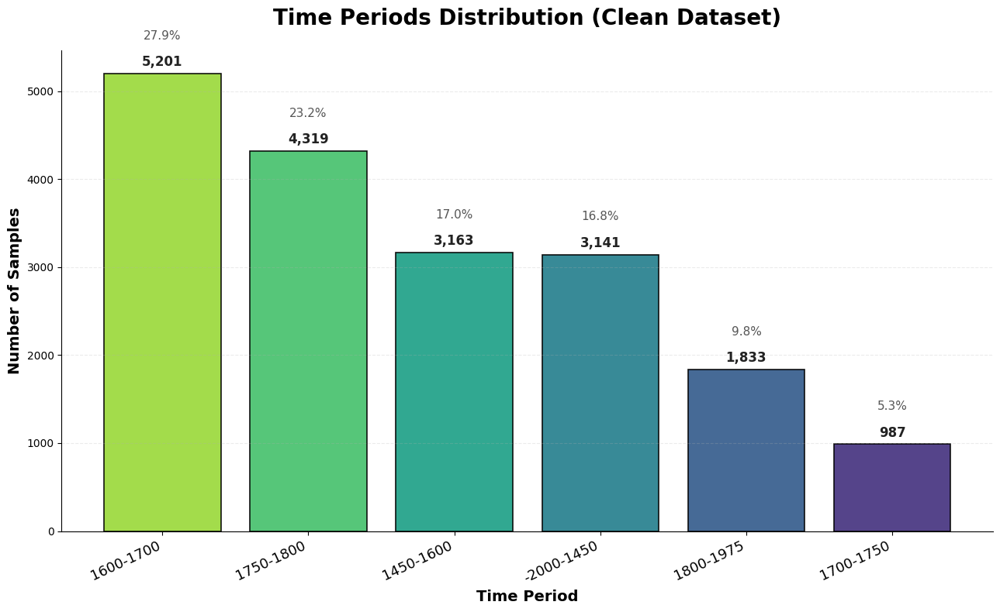

Saved as 11_time_periods_clean_pretty.png


In [39]:
# Time Periods Analysis for Clean Dataset - Single Graph (Prettified)
import matplotlib.pyplot as plt
import matplotlib.ticker as mtick

# Use period_counts and period_boundaries already defined
fig, ax = plt.subplots(figsize=(13, 8))

# Choose a modern color palette
colors = plt.cm.viridis_r(np.linspace(0.15, 0.85, len(period_counts)))

bars = ax.bar(
    range(len(period_counts)),
    period_counts.values,
    color=colors,
    edgecolor='black',
    linewidth=1.2,
    alpha=0.92
)

ax.set_title('Time Periods Distribution (Clean Dataset)', fontsize=20, fontweight='bold', pad=24)
ax.set_ylabel('Number of Samples', fontsize=14, fontweight='bold')
ax.set_xlabel('Time Period', fontsize=14, fontweight='bold')
ax.set_xticks(range(len(period_counts)))
ax.set_xticklabels(period_counts.index, rotation=25, ha='right', fontsize=13)
ax.grid(axis='y', alpha=0.25, linestyle='--')

# Add value labels on bars
for bar, value in zip(bars, period_counts.values):
    height = bar.get_height()
    ax.text(
        bar.get_x() + bar.get_width() / 2.,
        height + max(period_counts.values) * 0.01,
        f'{value:,}',
        ha='center',
        va='bottom',
        fontweight='bold',
        fontsize=12,
        color='#222'
    )

# Add percentage labels above bars
total = period_counts.sum()
for bar, value in zip(bars, period_counts.values):
    percent = value / total * 100
    ax.text(
        bar.get_x() + bar.get_width() / 2.,
        bar.get_height() + max(period_counts.values) * 0.07,
        f'{percent:.1f}%',
        ha='center',
        va='bottom',
        fontsize=11,
        color='#555'
    )

# Remove top/right spines for a cleaner look
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.tight_layout()
plt.savefig(f"{output_dir}/11_time_periods_clean_pretty.png", dpi=300, bbox_inches='tight')
plt.show()
print("Saved as 11_time_periods_clean_pretty.png")


🎯 Creating final visualization: Top Object Names Distribution...


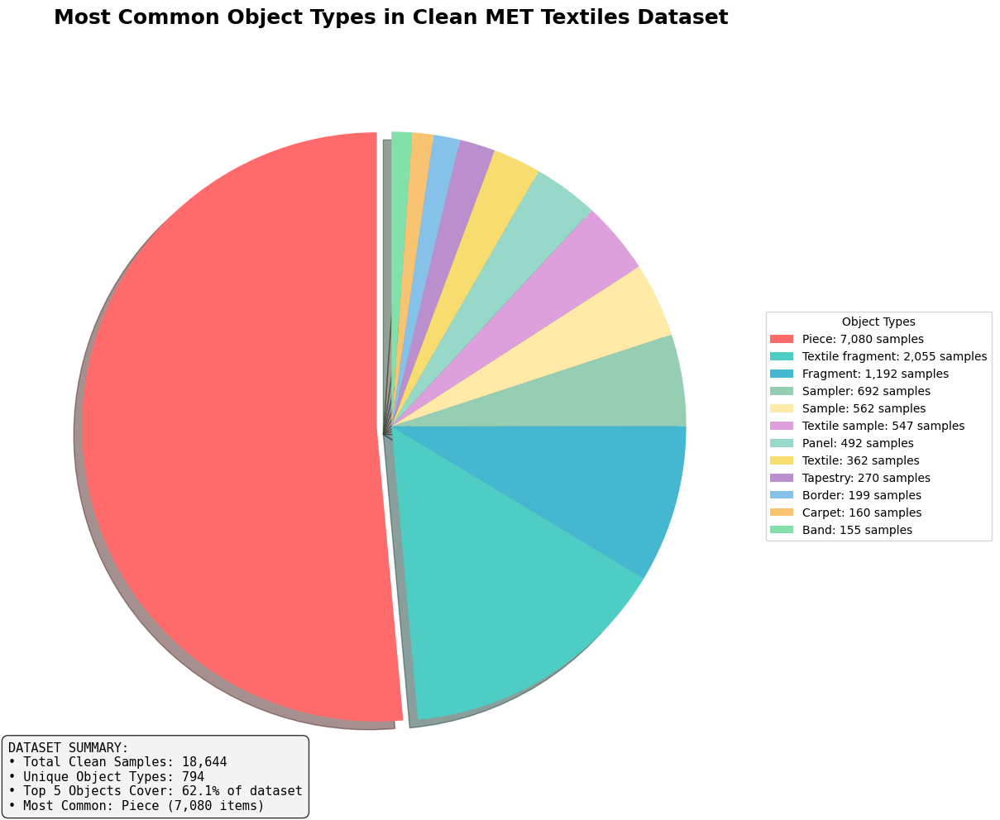


🎨 FINAL VISUALIZATION SUMMARY:
📊 Total unique object types: 794
🏆 Most common object: Piece (7,080 samples)
📈 Top 5 objects represent 62.1% of the dataset
💾 Visualization saved as: 12_object_names_distribution_final.png

✨ Analysis complete! All visualizations have been generated and saved.


In [42]:
# Final Visualization: Top Object Names Distribution (Clean Dataset)
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Get top object names from clean dataset
print("🎯 Creating final visualization: Top Object Names Distribution...")

object_counts = clean_df['objectName'].value_counts().head(12)

# Create a beautiful pie chart with enhanced styling
fig, ax = plt.subplots(figsize=(14, 10))

# Custom colors - using a professional color palette
colors = ['#FF6B6B', '#4ECDC4', '#45B7D1', '#96CEB4', '#FFEAA7', '#DDA0DD', 
          '#98D8C8', '#F7DC6F', '#BB8FCE', '#85C1E9', '#F8C471', '#82E0AA']

# Create pie chart WITHOUT labels or percentages on the wedges
wedges, _ = ax.pie(
    object_counts.values,
    labels=None,
    autopct=None,
    colors=colors[:len(object_counts)],
    startangle=90,
    explode=[0.05 if i == 0 else 0 for i in range(len(object_counts))],
    shadow=True,
)

# Enhance the appearance
ax.set_title('Most Common Object Types in Clean MET Textiles Dataset', 
             fontsize=18, fontweight='bold', pad=30)

# Add a legend with sample counts
legend_labels = [f"{name}: {count:,} samples" for name, count in object_counts.items()]
ax.legend(wedges, legend_labels, title="Object Types", loc="center left", 
          bbox_to_anchor=(1, 0, 0.5, 1), fontsize=10)

# Add summary statistics in a text box
total_objects = len(clean_df)
top_5_sum = object_counts.head(5).sum()
coverage = (top_5_sum / total_objects) * 100

stats_text = f"DATASET SUMMARY:\n"
stats_text += f"• Total Clean Samples: {total_objects:,}\n"
stats_text += f"• Unique Object Types: {clean_df['objectName'].nunique():,}\n"
stats_text += f"• Top 5 Objects Cover: {coverage:.1f}% of dataset\n"
stats_text += f"• Most Common: {object_counts.index[0]} ({object_counts.iloc[0]:,} items)"

ax.text(-1.3, -1.3, stats_text, fontsize=11, fontfamily='monospace',
        bbox=dict(boxstyle="round,pad=0.5", facecolor='#f0f0f0', alpha=0.8))

plt.tight_layout()
plt.savefig(f"{output_dir}/12_object_names_distribution_final.png", dpi=300, bbox_inches='tight')
plt.show()

print(f"\n🎨 FINAL VISUALIZATION SUMMARY:")
print(f"📊 Total unique object types: {clean_df['objectName'].nunique():,}")
print(f"🏆 Most common object: {object_counts.index[0]} ({object_counts.iloc[0]:,} samples)")
print(f"📈 Top 5 objects represent {coverage:.1f}% of the dataset")
print(f"💾 Visualization saved as: 12_object_names_distribution_final.png")
print(f"\n✨ Analysis complete! All visualizations have been generated and saved.")
